<a href="https://colab.research.google.com/github/LAODERUSMIANTO/ANALISIS-ENERGI-GELOMBANG-LAUT/blob/main/PETA_HS_DAN_DIRECTION.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### **PLOT HS 10 TAHUN**

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 45.5 MB/s eta 0:00:00


/usr/local/lib/python3.10/dist-packages/pyogrio/geopandas.py:265: UserWarning: More than one layer found in 'wakatobi': 'ADMINISTRASIKABKOTA_AR_50K' (default), 'ADMINISTRASIKECAMATAN_AR_50K', 'AGRIKEBUN_AR_50K', 'ADMINISTRASIKECAMATAN_LN_50K', 'AGRILADANG_AR_50K', 'BANGUNAN_PT_50K', 'AGRITANAMCAMPUR_AR_50K', 'BETING_LN_50K', 'DANAU_AR_50K', 'DERMAGA_PT_50K', 'DERMAGA_LN_50K', 'EMPANG_AR_50K', 'JALAN_LN_50K', 'GARISRPANTAI_LN_50K', 'JEMBATAN_PT_50K', 'MAKAM_PT_50K', 'KONTUR_LN_50K', 'NONAGRIHUTANKERING_AR_50K', 'NONAGRIALANG_AR_50K', 'NONAGRIHUTANBASAH_AR_50K', 'NONAGRISEMAKBELUKAR_AR_50K', 'PEMERINTAHAN_PT_50K', 'PASIR_AR_50K', 'RAWA_AR_50K', 'PEMUKIMAN_AR_50K', 'PESISIR_AR_50K', 'SARANAIBADAH_PT_50K', 'SUNGAI_LN_50K', 'SPOTHEIGHT_PT_50K', 'TOPONIMI_PT_50K', 'TAMBANGAN_PT_50K', 'titik WW3'. Specify layer parameter to avoid this warning.
  result = read_func(


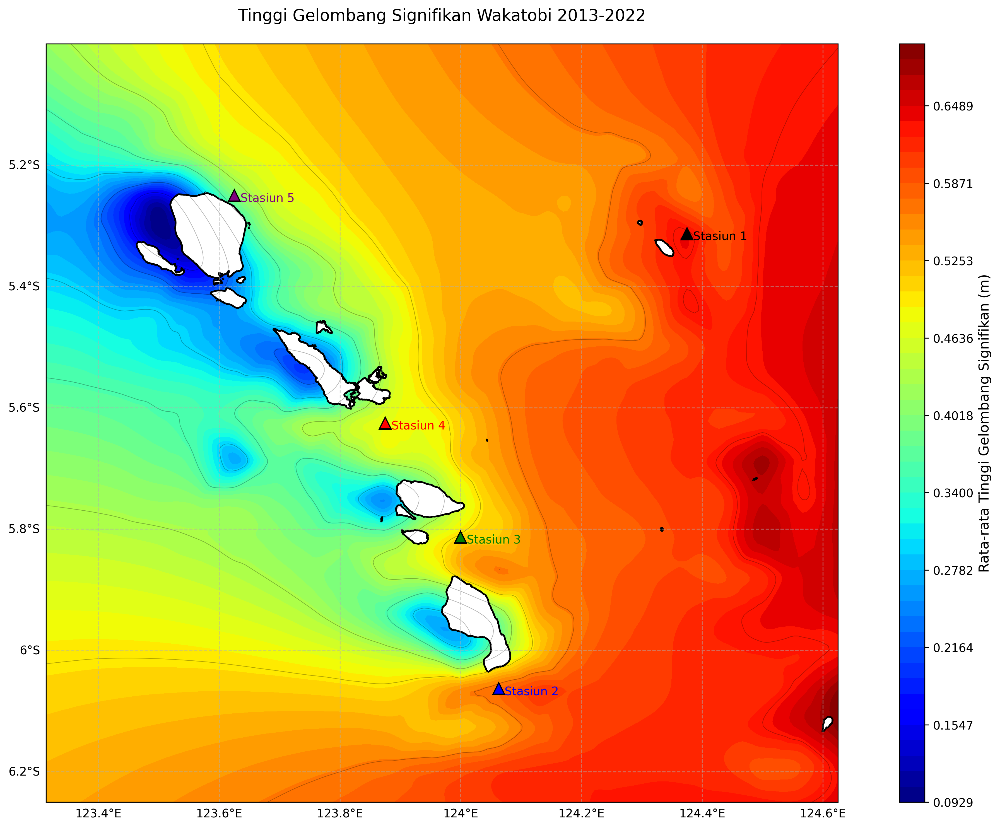

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
!pip install cartopy
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Buat folder output jika belum ada
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Baca data
shapefile_path = '/content/drive/MyDrive/wakatobi'
ds = xr.open_dataset('/content/drive/MyDrive/data nc/tahunan/combined10tahun.nc')

# Pastikan variabel 'hs' ada dalam dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path)

# Hitung rata-rata tinggi gelombang sepanjang waktu
hs_mean = ds['hs'].mean(dim='time')

# Buat grid untuk interpolasi
lon = ds.lon.values
lat = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon, lat)

# Buat grid yang lebih halus untuk interpolasi
lon_new = np.linspace(lon.min(), lon.max(), 200)
lat_new = np.linspace(lat.min(), lat.max(), 200)
lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

# Interpolasi data
points = np.column_stack((lon_mesh.flatten(), lat_mesh.flatten()))
values = hs_mean.values.flatten()
grid_z = griddata(points, values, (lon_mesh_new, lat_mesh_new), method='cubic')

# Tentukan nilai min dan max
vmin = np.nanmin(grid_z)
vmax = np.nanmax(grid_z)

# Buat plot
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot data tinggi gelombang
plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_z,
                    levels=np.linspace(vmin, vmax, 50),
                    cmap='jet',
                    transform=ccrs.PlateCarree())

# Tambahkan kontur garis
plt.contour(lon_mesh_new, lat_mesh_new, grid_z,
            levels=np.linspace(vmin, vmax, 10),
            colors='black',
            alpha=0.3,
            linewidths=0.5,
            transform=ccrs.PlateCarree())

# Plot shapefile Wakatobi sebagai garis pantai dengan fill warna putih
gdf_wakatobi.plot(ax=ax,
                  edgecolor='black',
                  facecolor='white',
                  linewidth=1.5,
                  transform=ccrs.PlateCarree())

# Tambahkan gridlines dengan label longitude dan latitude
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Tambahkan label untuk Longitude dan Latitude
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Tambahkan colorbar di sebelah kanan
cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
cbar.set_label('Rata-rata Tinggi Gelombang Signifikan (m)', fontsize=12)

# Atur extent peta sesuai dengan gambar yang Anda inginkan
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Tambahkan judul
plt.title('Tinggi Gelombang Signifikan Wakatobi 2013-2022',
          pad=20, fontsize=14)

# Tambahkan simbol lokasi pada koordinat yang ditentukan
coords = [
    (124.375, -5.313, 'Stasiun 1'),
    (124.063, -6.063, 'Stasiun 2'),
    (124.000, -5.813, 'Stasiun 3'),
    (123.875, -5.625, 'Stasiun 4'),
    (123.625, -5.250, 'Stasiun 5')
]

# Daftar warna untuk setiap stasiun
colors = ['black', 'blue', 'green', 'red', 'purple']

for (lon, lat, label), color in zip(coords, colors):
    ax.plot(lon, lat, '^', markerfacecolor=color, markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())
    ax.text(lon + 0.01, lat - 0.01, label, fontsize=10, color=color, transform=ccrs.PlateCarree())  # Offset teks sedikit dari titik

plt.tight_layout()
plt.show()


In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
!pip install cartopy
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Buat folder output jika belum ada
output_folder = '/content/drive/MyDrive/output/annual_plots'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Baca data
shapefile_path = '/content/drive/MyDrive/wakatobi'
ds = xr.open_dataset('/content/drive/MyDrive/data nc/tahunan/combined10tahun.nc')

# Pastikan variabel 'hs' ada dalam dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path)

# Koordinat untuk stasiun dan warna masing-masing stasiun
coords = [
    (124.375, -5.313, 'Stasiun 1'),
    (124.063, -6.063, 'Stasiun 2'),
    (124.000, -5.813, 'Stasiun 3'),
    (123.875, -5.625, 'Stasiun 4'),
    (123.625, -5.250, 'Stasiun 5')
]
colors = ['black', 'blue', 'green', 'red', 'purple']

# Buat grid interpolasi
lon = ds.lon.values
lat = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon, lat)
lon_new = np.linspace(lon.min(), lon.max(), 200)
lat_new = np.linspace(lat.min(), lat.max(), 200)
lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

# Plot setiap tahun
for year in range(2013, 2023):
    # Pilih data untuk tahun tersebut
    year_data = ds.sel(time=str(year))
    hs_mean = year_data['hs'].mean(dim='time')

    # Interpolasi data ke grid yang lebih halus
    points = np.column_stack((lon_mesh.flatten(), lat_mesh.flatten()))
    values = hs_mean.values.flatten()
    grid_z = griddata(points, values, (lon_mesh_new, lat_mesh_new), method='cubic')

    # Tentukan batas minimum dan maksimum untuk skala warna
    vmin = np.nanmin(grid_z)
    vmax = np.nanmax(grid_z)

    # Buat plot
    plt.figure(figsize=(15, 10), dpi=300)
    ax = plt.axes(projection=ccrs.PlateCarree())

    # Plot kontur tinggi gelombang
    plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_z,
                        levels=np.linspace(vmin, vmax, 50),
                        cmap='jet',
                        transform=ccrs.PlateCarree())

    # Tambahkan kontur garis
    plt.contour(lon_mesh_new, lat_mesh_new, grid_z,
                levels=np.linspace(vmin, vmax, 10),
                colors='black',
                alpha=0.3,
                linewidths=0.5,
                transform=ccrs.PlateCarree())

    # Plot shapefile Wakatobi sebagai garis pantai dengan fill warna putih
    gdf_wakatobi.plot(ax=ax,
                      edgecolor='black',
                      facecolor='white',
                      linewidth=1.5,
                      transform=ccrs.PlateCarree())

    # Tambahkan simbol lokasi stasiun
    for (lon, lat, label), color in zip(coords, colors):
        ax.plot(lon, lat, '^', markerfacecolor=color, markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())
        ax.text(lon + 0.01, lat - 0.01, label, fontsize=10, color=color, transform=ccrs.PlateCarree())

    # Atur area peta dan label
    ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())
    ax.set_xlabel('Longitude (°E)', fontsize=12)
    ax.set_ylabel('Latitude (°S)', fontsize=12)
    plt.title(f'Tinggi Gelombang Signifikan Wakatobi - {year}', pad=20, fontsize=14)

    # Tambahkan colorbar
    cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
    cbar.set_label('Rata-rata Tinggi Gelombang Signifikan (m)', fontsize=12)

    # Simpan plot untuk setiap tahun
    plt.tight_layout()
    plt.savefig(f'{output_folder}/hs_mean_{year}.png', bbox_inches='tight')
    plt.close()

print(f"Semua plot tahunan disimpan di {output_folder}")


/usr/local/lib/python3.10/dist-packages/pyogrio/geopandas.py:265: UserWarning: More than one layer found in 'wakatobi': 'ADMINISTRASIKABKOTA_AR_50K' (default), 'ADMINISTRASIKECAMATAN_AR_50K', 'AGRIKEBUN_AR_50K', 'ADMINISTRASIKECAMATAN_LN_50K', 'AGRILADANG_AR_50K', 'BANGUNAN_PT_50K', 'AGRITANAMCAMPUR_AR_50K', 'BETING_LN_50K', 'DANAU_AR_50K', 'DERMAGA_PT_50K', 'DERMAGA_LN_50K', 'EMPANG_AR_50K', 'JALAN_LN_50K', 'GARISRPANTAI_LN_50K', 'JEMBATAN_PT_50K', 'MAKAM_PT_50K', 'KONTUR_LN_50K', 'NONAGRIHUTANKERING_AR_50K', 'NONAGRIALANG_AR_50K', 'NONAGRIHUTANBASAH_AR_50K', 'NONAGRISEMAKBELUKAR_AR_50K', 'PEMERINTAHAN_PT_50K', 'PASIR_AR_50K', 'RAWA_AR_50K', 'PEMUKIMAN_AR_50K', 'PESISIR_AR_50K', 'SARANAIBADAH_PT_50K', 'SUNGAI_LN_50K', 'SPOTHEIGHT_PT_50K', 'TOPONIMI_PT_50K', 'TAMBANGAN_PT_50K', 'titik WW3'. Specify layer parameter to avoid this warning.
  result = read_func(


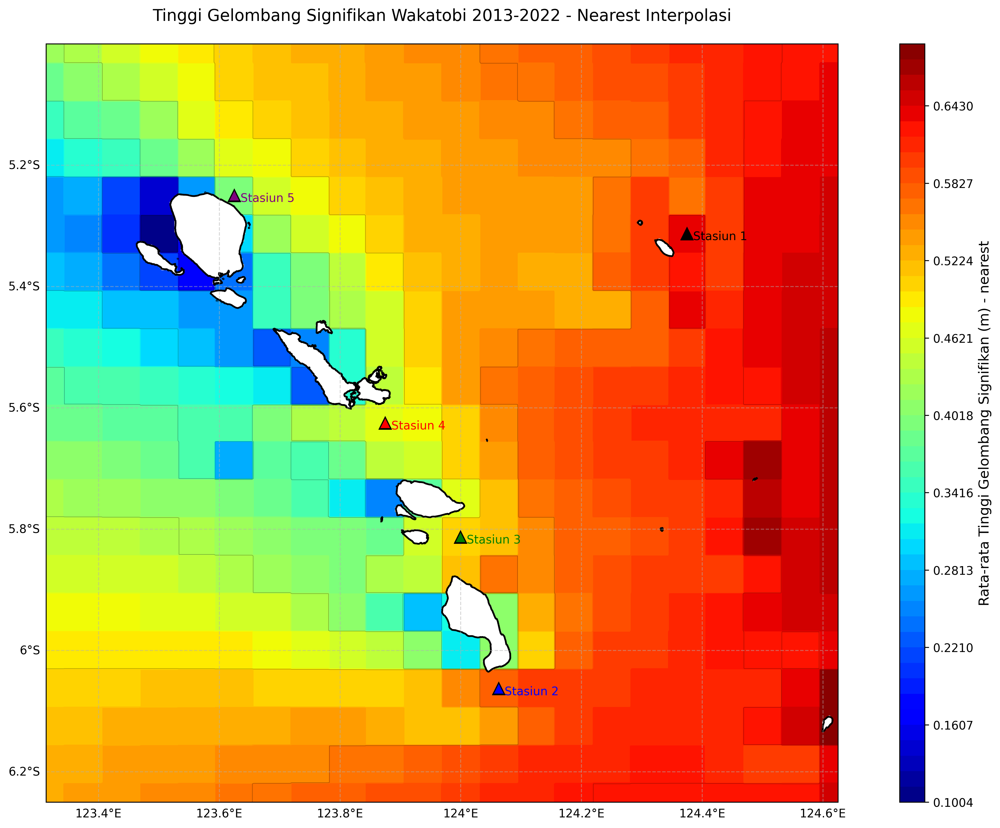

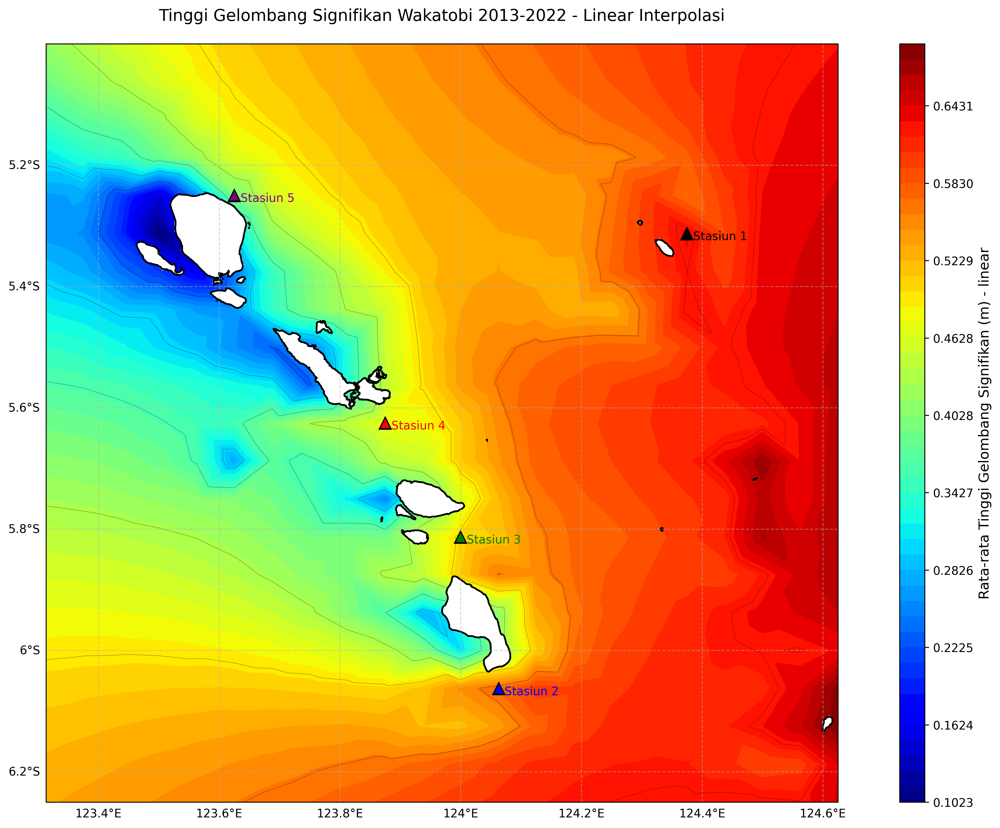

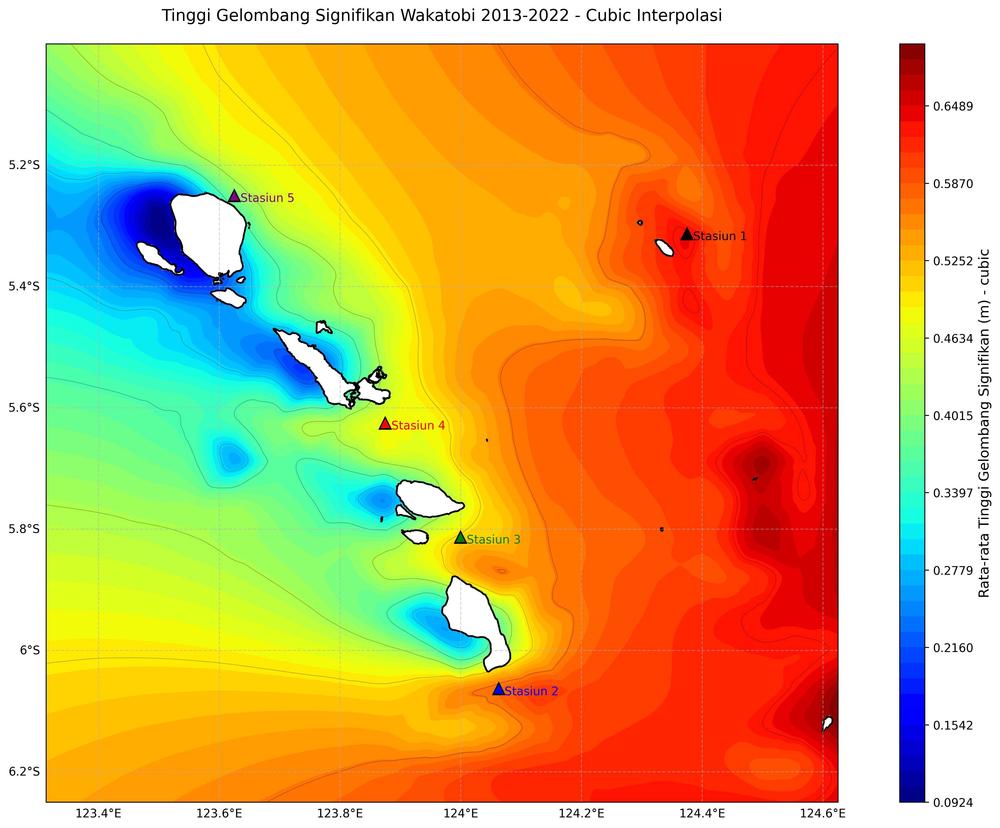

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from shapely.geometry import Point
from shapely.ops import unary_union
from scipy.interpolate import griddata

# Set output folder
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Load dataset
ds = xr.open_dataset('/content/drive/MyDrive/data nc/tahunan/combined10tahun.nc')

# Pastikan variabel 'hs' ada di dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan di dataset.")

# Load shapefile Wakatobi dan pilih layer yang berisi batas wilayah laut
shapefile_path = '/content/drive/MyDrive/wakatobi'
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')  # Ganti dengan layer yang sesuai

# Hitung rata-rata tinggi gelombang
hs_mean = ds['hs'].mean(dim='time')

# Koordinat grid asli
lon_array = ds.lon.values
lat_array = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon_array, lat_array)

# Level interpolasi
interpolation_level = 500

# Grid baru untuk interpolasi
lon_new = np.linspace(lon_array.min(), lon_array.max(), interpolation_level)
lat_new = np.linspace(lat_array.min(), lat_array.max(), interpolation_level)
lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

# Masking dengan shapefile untuk memastikan nilai hanya muncul di laut
ocean_mask = unary_union([geom for geom in gdf_wakatobi.geometry if geom.is_valid])
mask = np.array([
    ocean_mask.contains(Point(lon, lat))
    for lon, lat in zip(lon_mesh_new.ravel(), lat_mesh_new.ravel())
]).reshape(lon_mesh_new.shape)

# Pembalikan mask: hanya nilai laut yang tersisa
mask = ~mask  # Balik mask agar hanya laut yang memiliki nilai (True)

# Metode interpolasi
methods = ['nearest', 'linear', 'cubic']
for method in methods:
    # Interpolasi data
    grid_z = griddata(
        (lon_mesh.flatten(), lat_mesh.flatten()), hs_mean.values.flatten(),
        (lon_mesh_new, lat_mesh_new), method=method
    )

    # Terapkan mask pada data interpolasi
    grid_z[~mask] = np.nan  # Hanya area laut yang memiliki nilai, daratan menjadi NaN

    # Batas nilai plot
    vmin = np.nanmin(grid_z)
    vmax = np.nanmax(grid_z)

    # Plotting
    plt.figure(figsize=(15, 10), dpi=300)
    ax = plt.axes(projection=ccrs.PlateCarree())

    # Plotting data tinggi gelombang yang sudah diinterpolasi
    plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_z,
                        levels=np.linspace(vmin, vmax, 50),
                        cmap='jet',
                        transform=ccrs.PlateCarree())

    # Garis kontur
    plt.contour(lon_mesh_new, lat_mesh_new, grid_z,
                levels=np.linspace(vmin, vmax, 10),
                colors='black',
                alpha=0.3,
                linewidths=0.5,
                transform=ccrs.PlateCarree())

    # Plot batas shapefile Wakatobi
    gdf_wakatobi.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1.5, transform=ccrs.PlateCarree())

    # Garis grid dengan label
    gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
    gl.top_labels = False
    gl.right_labels = False

    # Label sumbu
    ax.set_xlabel('Longitude (°E)', fontsize=12)
    ax.set_ylabel('Latitude (°S)', fontsize=12)

    # Warna untuk baris warna
    cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
    cbar.set_label(f'Rata-rata Tinggi Gelombang Signifikan (m) - {method}', fontsize=12)

    # Set batas peta
    ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

    # Judul
    plt.title(f'Tinggi Gelombang Signifikan Wakatobi 2013-2022 - {method.capitalize()} Interpolasi',
              pad=20, fontsize=14)

    # Simbol stasiun dan label
    coords = [
        (124.375, -5.313, 'Stasiun 1'),
        (124.063, -6.063, 'Stasiun 2'),
        (124.000, -5.813, 'Stasiun 3'),
        (123.875, -5.625, 'Stasiun 4'),
        (123.625, -5.250, 'Stasiun 5')
    ]
    colors = ['black', 'blue', 'green', 'red', 'purple']

    for (lon, lat, label), color in zip(coords, colors):
        ax.plot(lon, lat, '^', markerfacecolor=color, markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())
        ax.text(lon + 0.01, lat - 0.01, label, fontsize=10, color=color, transform=ccrs.PlateCarree())

    plt.tight_layout()
    plt.show()


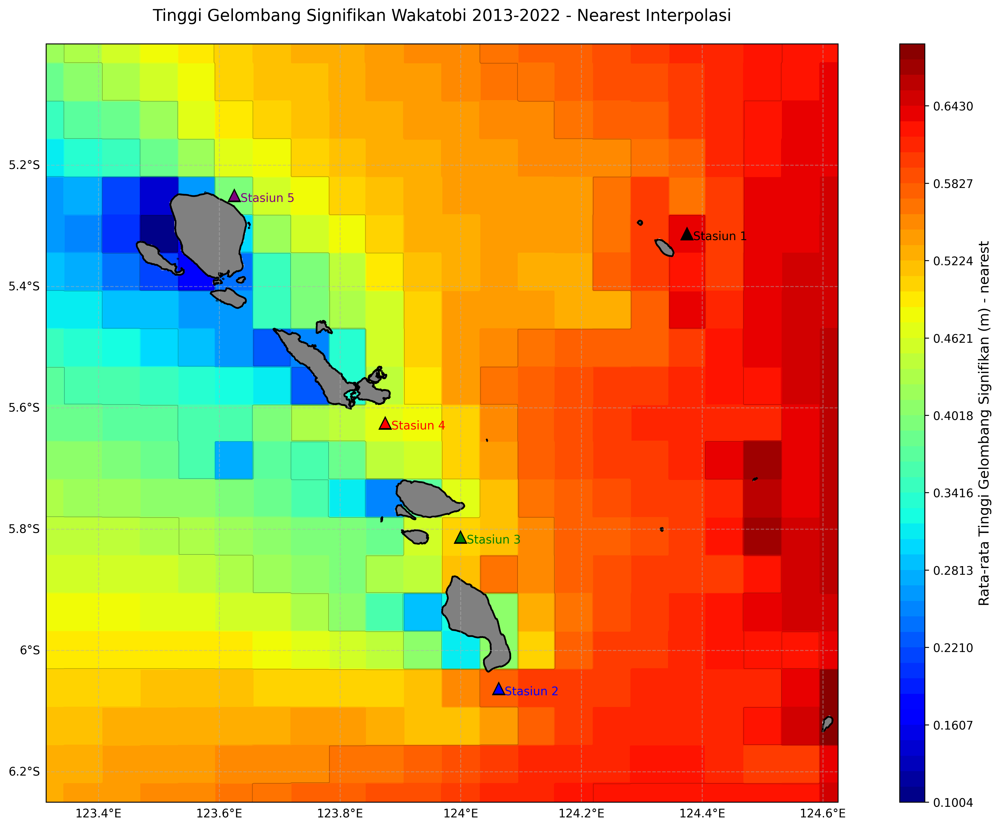

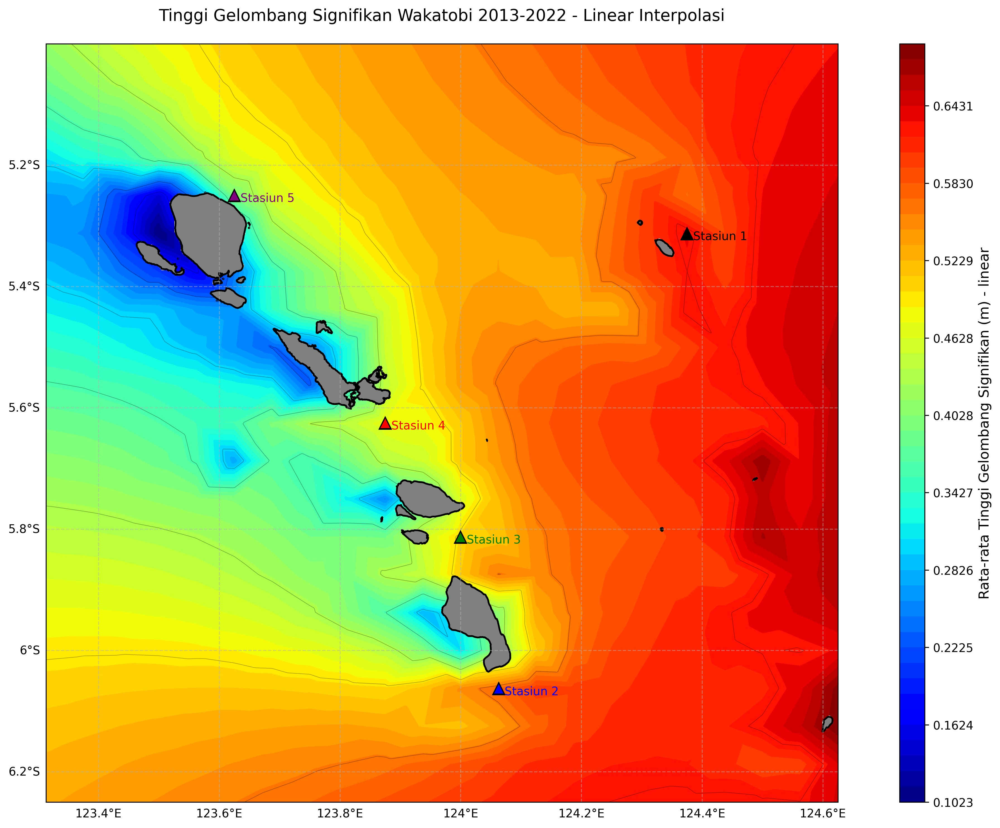

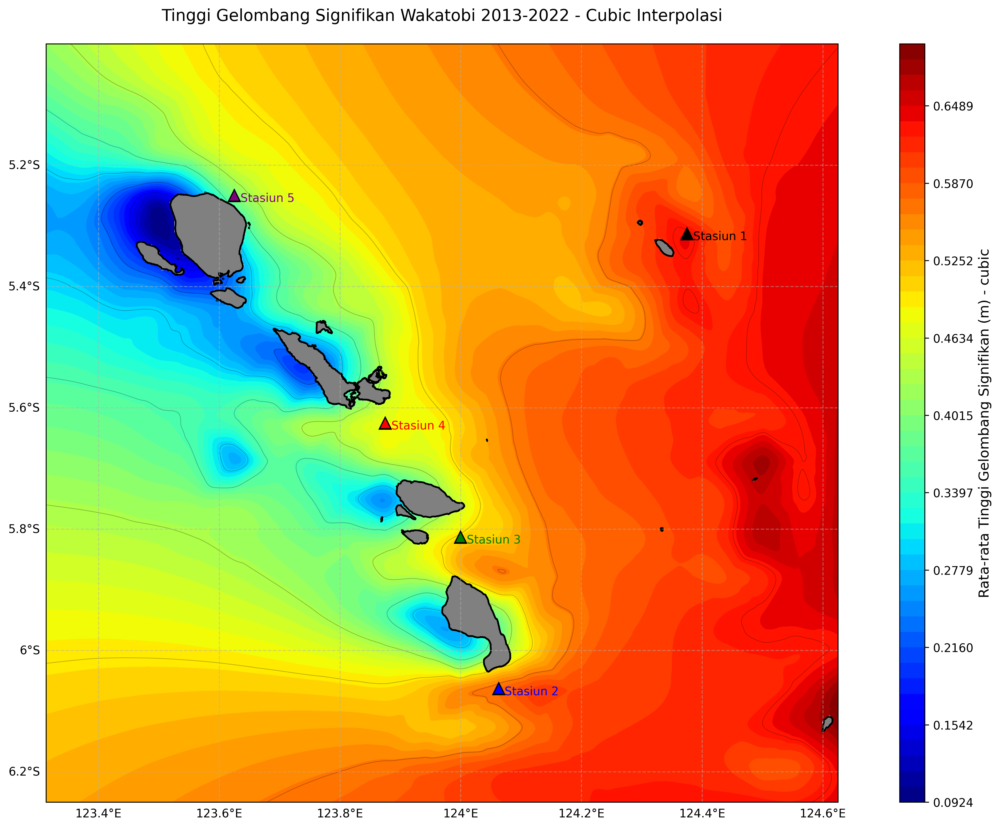

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from shapely.geometry import Point
from shapely.ops import unary_union
from scipy.interpolate import griddata

# Set output folder
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Load dataset
ds = xr.open_dataset('/content/drive/MyDrive/data nc/tahunan/combined10tahun.nc')

# Pastikan variabel 'hs' ada di dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan di dataset.")

# Load shapefile Wakatobi dan pilih layer yang berisi batas wilayah laut
shapefile_path = '/content/drive/MyDrive/wakatobi'
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')  # Ganti dengan layer yang sesuai

# Hitung rata-rata tinggi gelombang
hs_mean = ds['hs'].mean(dim='time')

# Koordinat grid asli
lon_array = ds.lon.values
lat_array = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon_array, lat_array)

# Level interpolasi
interpolation_level = 500

# Grid baru untuk interpolasi
lon_new = np.linspace(lon_array.min(), lon_array.max(), interpolation_level)
lat_new = np.linspace(lat_array.min(), lat_array.max(), interpolation_level)
lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

# Masking dengan shapefile untuk memastikan nilai hanya muncul di laut
ocean_mask = unary_union([geom for geom in gdf_wakatobi.geometry if geom.is_valid])
mask = np.array([
    ocean_mask.contains(Point(lon, lat))
    for lon, lat in zip(lon_mesh_new.ravel(), lat_mesh_new.ravel())
]).reshape(lon_mesh_new.shape)

# Pembalikan mask: hanya nilai laut yang tersisa
mask = ~mask  # Balik mask agar hanya laut yang memiliki nilai (True)

# Metode interpolasi
methods = ['nearest', 'linear', 'cubic']
for method in methods:
    # Interpolasi data
    grid_z = griddata(
        (lon_mesh.flatten(), lat_mesh.flatten()), hs_mean.values.flatten(),
        (lon_mesh_new, lat_mesh_new), method=method
    )

    # Terapkan mask pada data interpolasi
    grid_z[~mask] = np.nan  # Hanya area laut yang memiliki nilai, daratan menjadi NaN

    # Batas nilai plot
    vmin = np.nanmin(grid_z)
    vmax = np.nanmax(grid_z)

    # Plotting
    plt.figure(figsize=(15, 10), dpi=300)
    ax = plt.axes(projection=ccrs.PlateCarree())

    # Plotting data tinggi gelombang yang sudah diinterpolasi
    plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_z,
                        levels=np.linspace(vmin, vmax, 50),
                        cmap='jet',
                        transform=ccrs.PlateCarree())

    # Garis kontur
    plt.contour(lon_mesh_new, lat_mesh_new, grid_z,
                levels=np.linspace(vmin, vmax, 10),
                colors='black',
                alpha=0.3,
                linewidths=0.5,
                transform=ccrs.PlateCarree())

    # Plot batas shapefile Wakatobi dengan warna abu-abu
    gdf_wakatobi.plot(ax=ax, edgecolor='black', facecolor='gray', linewidth=1.5, transform=ccrs.PlateCarree())

    # Garis grid dengan label
    gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
    gl.top_labels = False
    gl.right_labels = False

    # Label sumbu
    ax.set_xlabel('Longitude (°E)', fontsize=12)
    ax.set_ylabel('Latitude (°S)', fontsize=12)

    # Warna untuk baris warna
    cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
    cbar.set_label(f'Rata-rata Tinggi Gelombang Signifikan (m) - {method}', fontsize=12)

    # Set batas peta
    ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

    # Judul
    plt.title(f'Tinggi Gelombang Signifikan Wakatobi 2013-2022 - {method.capitalize()} Interpolasi',
              pad=20, fontsize=14)

    # Simbol stasiun dan label
    coords = [
        (124.375, -5.313, 'Stasiun 1'),
        (124.063, -6.063, 'Stasiun 2'),
        (124.000, -5.813, 'Stasiun 3'),
        (123.875, -5.625, 'Stasiun 4'),
        (123.625, -5.250, 'Stasiun 5')
    ]
    colors = ['black', 'blue', 'green', 'red', 'purple']

    for (lon, lat, label), color in zip(coords, colors):
        ax.plot(lon, lat, '^', markerfacecolor=color, markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())
        ax.text(lon + 0.01, lat - 0.01, label, fontsize=10, color=color, transform=ccrs.PlateCarree())

    plt.tight_layout()
    plt.show()


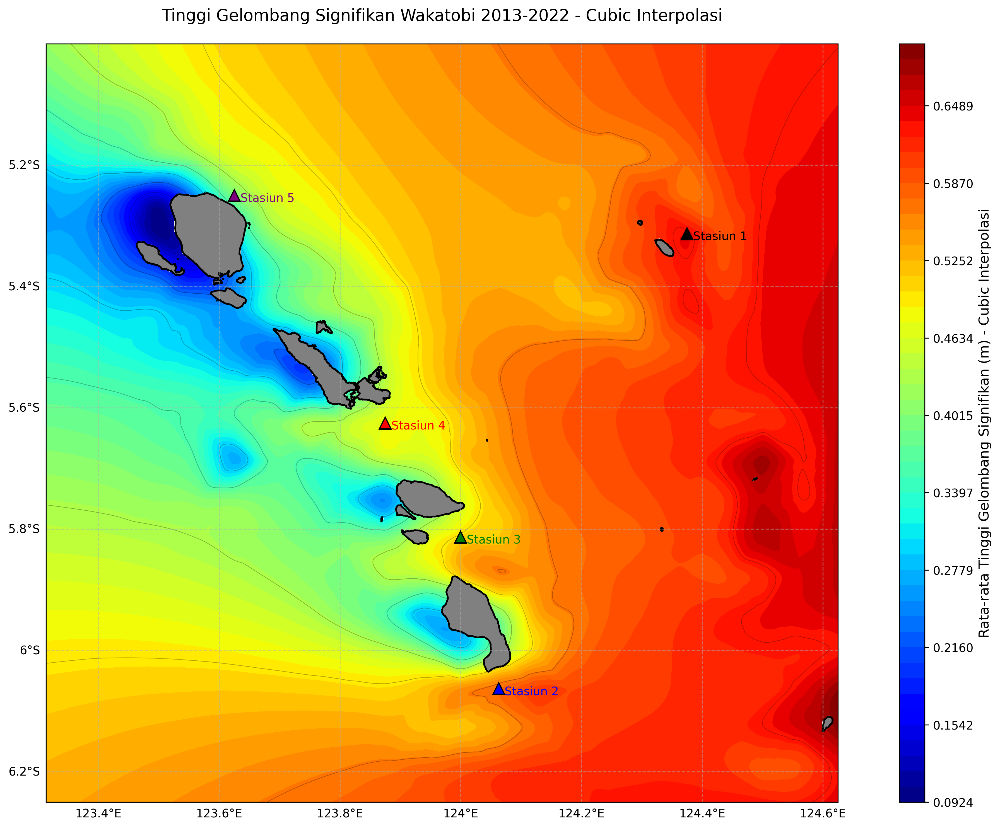

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from shapely.geometry import Point
from shapely.ops import unary_union
from scipy.interpolate import griddata

# Set output folder
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Load dataset
ds = xr.open_dataset('/content/drive/MyDrive/data nc/tahunan/combined10tahun.nc')

# Pastikan variabel 'hs' ada di dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan di dataset.")

# Load shapefile Wakatobi dan pilih layer yang berisi batas wilayah laut
shapefile_path = '/content/drive/MyDrive/wakatobi'
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')  # Ganti dengan layer yang sesuai

# Hitung rata-rata tinggi gelombang
hs_mean = ds['hs'].mean(dim='time')

# Koordinat grid asli
lon_array = ds.lon.values
lat_array = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon_array, lat_array)

# Level interpolasi
interpolation_level = 500

# Grid baru untuk interpolasi
lon_new = np.linspace(lon_array.min(), lon_array.max(), interpolation_level)
lat_new = np.linspace(lat_array.min(), lat_array.max(), interpolation_level)
lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

# Masking dengan shapefile untuk memastikan nilai hanya muncul di laut
ocean_mask = unary_union([geom for geom in gdf_wakatobi.geometry if geom.is_valid])
mask = np.array([
    ocean_mask.contains(Point(lon, lat))
    for lon, lat in zip(lon_mesh_new.ravel(), lat_mesh_new.ravel())
]).reshape(lon_mesh_new.shape)

# Pembalikan mask: hanya nilai laut yang tersisa
mask = ~mask  # Balik mask agar hanya laut yang memiliki nilai (True)

# Interpolasi cubic
grid_z = griddata(
    (lon_mesh.flatten(), lat_mesh.flatten()), hs_mean.values.flatten(),
    (lon_mesh_new, lat_mesh_new), method='cubic'
)

# Terapkan mask pada data interpolasi
grid_z[~mask] = np.nan  # Hanya area laut yang memiliki nilai, daratan menjadi NaN

# Batas nilai plot
vmin = np.nanmin(grid_z)
vmax = np.nanmax(grid_z)

# Plotting
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plotting data tinggi gelombang yang sudah diinterpolasi
plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_z,
                    levels=np.linspace(vmin, vmax, 50),
                    cmap='jet',
                    transform=ccrs.PlateCarree())

# Garis kontur
plt.contour(lon_mesh_new, lat_mesh_new, grid_z,
            levels=np.linspace(vmin, vmax, 10),
            colors='black',
            alpha=0.3,
            linewidths=0.5,
            transform=ccrs.PlateCarree())

# Plot batas shapefile Wakatobi dengan warna abu-abu
gdf_wakatobi.plot(ax=ax, edgecolor='black', facecolor='gray', linewidth=1.5, transform=ccrs.PlateCarree())

# Garis grid dengan label
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Label sumbu
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Warna untuk baris warna
cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
cbar.set_label('Rata-rata Tinggi Gelombang Signifikan (m) - Cubic Interpolasi', fontsize=12)

# Set batas peta
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Judul
plt.title('Tinggi Gelombang Signifikan Wakatobi 2013-2022 - Cubic Interpolasi', pad=20, fontsize=14)

# Simbol stasiun dan label
coords = [
    (124.375, -5.313, 'Stasiun 1'),
    (124.063, -6.063, 'Stasiun 2'),
    (124.000, -5.813, 'Stasiun 3'),
    (123.875, -5.625, 'Stasiun 4'),
    (123.625, -5.250, 'Stasiun 5')
]
colors = ['black', 'blue', 'green', 'red', 'purple']

for (lon, lat, label), color in zip(coords, colors):
    ax.plot(lon, lat, '^', markerfacecolor=color, markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())
    ax.text(lon + 0.01, lat - 0.01, label, fontsize=10, color=color, transform=ccrs.PlateCarree())

plt.tight_layout()
plt.show()


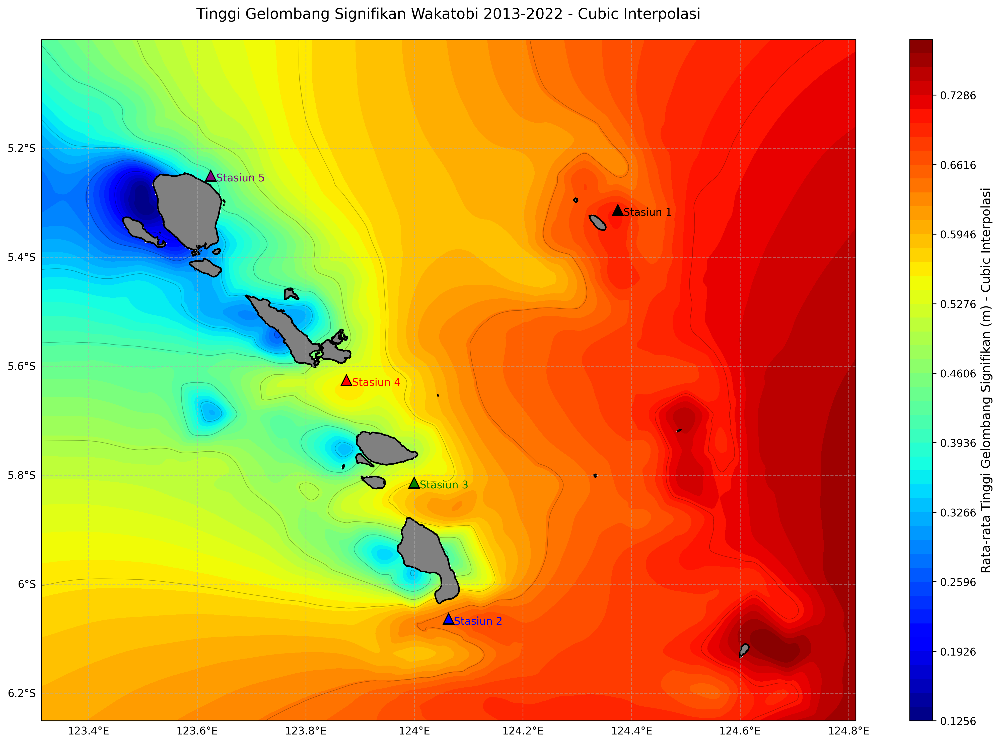

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
!pip install cartopy
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from shapely.geometry import Point
from shapely.ops import unary_union
from scipy.interpolate import griddata

# Set output folder
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Load dataset
ds = xr.open_dataset('/content/drive/MyDrive/DATA WAKATOBI/OUTPUT/DATA TAHUNAN/TAHUN2022.nc')

# Pastikan variabel 'hs' ada di dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan di dataset.")

# Load shapefile Wakatobi dan pilih layer yang berisi batas wilayah laut
shapefile_path = '/content/drive/MyDrive/wakatobi'
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')  # Ganti dengan layer yang sesuai

# Hitung rata-rata tinggi gelombang
hs_mean = ds['hs'].mean(dim='time')

# Koordinat grid asli
lon_array = ds.lon.values
lat_array = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon_array, lat_array)

# Level interpolasi
interpolation_level = 500

# Grid baru untuk interpolasi
lon_new = np.linspace(lon_array.min(), lon_array.max(), interpolation_level)
lat_new = np.linspace(lat_array.min(), lat_array.max(), interpolation_level)
lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

# Masking dengan shapefile untuk memastikan nilai hanya muncul di laut
ocean_mask = unary_union([geom for geom in gdf_wakatobi.geometry if geom.is_valid])
mask = np.array([
    ocean_mask.contains(Point(lon, lat))
    for lon, lat in zip(lon_mesh_new.ravel(), lat_mesh_new.ravel())
]).reshape(lon_mesh_new.shape)

# Pembalikan mask: hanya nilai laut yang tersisa
mask = ~mask  # Balik mask agar hanya laut yang memiliki nilai (True)

# Interpolasi cubic
grid_z = griddata(
    (lon_mesh.flatten(), lat_mesh.flatten()), hs_mean.values.flatten(),
    (lon_mesh_new, lat_mesh_new), method='cubic'
)

# Terapkan mask pada data interpolasi
grid_z[~mask] = np.nan  # Hanya area laut yang memiliki nilai, daratan menjadi NaN

# Batas nilai plot
vmin = np.nanmin(grid_z)
vmax = np.nanmax(grid_z)

# Plotting
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plotting data tinggi gelombang yang sudah diinterpolasi
plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_z,
                    levels=np.linspace(vmin, vmax, 50),
                    cmap='jet',
                    transform=ccrs.PlateCarree())

# Garis kontur
plt.contour(lon_mesh_new, lat_mesh_new, grid_z,
            levels=np.linspace(vmin, vmax, 10),
            colors='black',
            alpha=0.3,
            linewidths=0.5,
            transform=ccrs.PlateCarree())

# Plot batas shapefile Wakatobi dengan warna abu-abu
gdf_wakatobi.plot(ax=ax, edgecolor='black', facecolor='gray', linewidth=1.5, transform=ccrs.PlateCarree())

# Garis grid dengan label
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Label sumbu
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Warna untuk baris warna
cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
cbar.set_label('Rata-rata Tinggi Gelombang Signifikan (m) - Cubic Interpolasi', fontsize=12)

# Set batas peta
ax.set_extent([123.313, 124.813, -6.25, -5], crs=ccrs.PlateCarree())

# Judul
plt.title('Tinggi Gelombang Signifikan Wakatobi 2013-2022 - Cubic Interpolasi', pad=20, fontsize=14)

# Simbol stasiun dan label
coords = [
    (124.375, -5.313, 'Stasiun 1'),
    (124.063, -6.063, 'Stasiun 2'),
    (124.000, -5.813, 'Stasiun 3'),
    (123.875, -5.625, 'Stasiun 4'),
    (123.625, -5.250, 'Stasiun 5')
]
colors = ['black', 'blue', 'green', 'red', 'purple']

for (lon, lat, label), color in zip(coords, colors):
    ax.plot(lon, lat, '^', markerfacecolor=color, markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())
    ax.text(lon + 0.01, lat - 0.01, label, fontsize=10, color=color, transform=ccrs.PlateCarree())

plt.tight_layout()
plt.show()


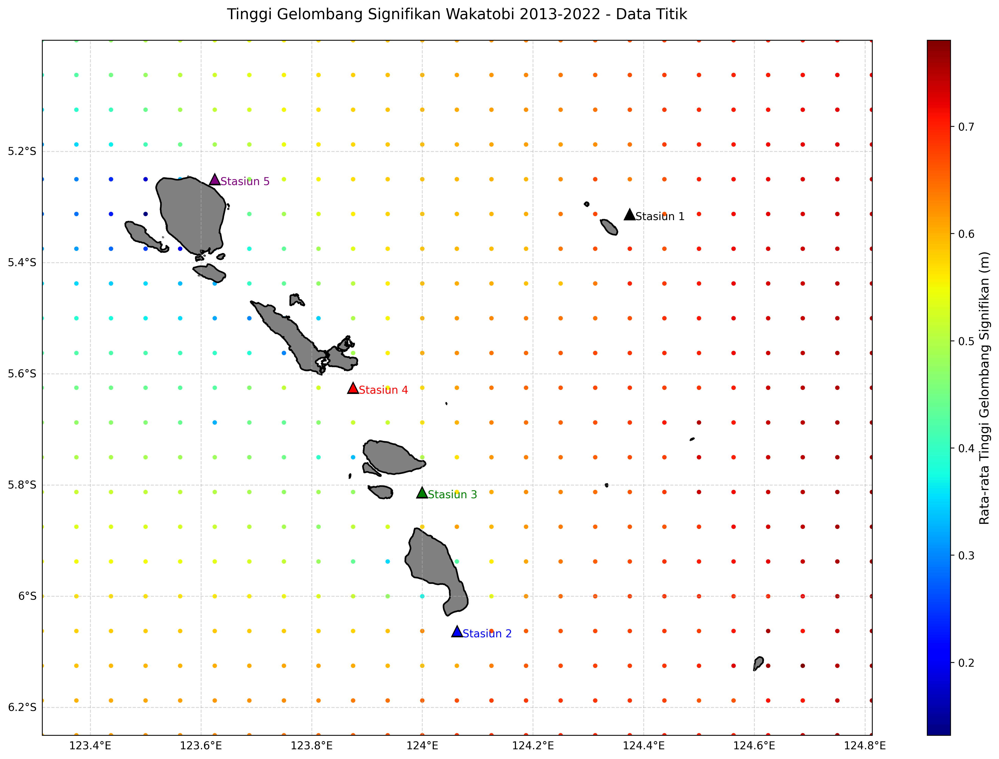

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np

# Set output folder
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Load dataset
ds = xr.open_dataset('/content/drive/MyDrive/DATA WAKATOBI/OUTPUT/DATA TAHUNAN/TAHUN2022.nc')

# Pastikan variabel 'hs' ada di dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan di dataset.")

# Load shapefile Wakatobi dan pilih layer yang berisi batas wilayah laut
shapefile_path = '/content/drive/MyDrive/wakatobi'
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')  # Ganti dengan layer yang sesuai

# Hitung rata-rata tinggi gelombang tanpa interpolasi
hs_mean = ds['hs'].mean(dim='time')

# Koordinat grid asli
lon_array = ds.lon.values
lat_array = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon_array, lat_array)

# Batas nilai plot
vmin = hs_mean.min().values
vmax = hs_mean.max().values

# Plotting
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plotting data tinggi gelombang dalam bentuk titik
sc = ax.scatter(lon_mesh, lat_mesh, c=hs_mean.values, cmap='jet', vmin=vmin, vmax=vmax, s=10, transform=ccrs.PlateCarree())

# Plot batas shapefile Wakatobi dengan warna abu-abu
gdf_wakatobi.plot(ax=ax, edgecolor='black', facecolor='gray', linewidth=1.5, transform=ccrs.PlateCarree())

# Garis grid dengan label
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Label sumbu
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Warna untuk baris warna
cbar = plt.colorbar(sc, orientation='vertical', pad=0.05, aspect=30)
cbar.set_label('Rata-rata Tinggi Gelombang Signifikan (m)', fontsize=12)

# Set batas peta
ax.set_extent([123.313, 124.813, -6.25, -5], crs=ccrs.PlateCarree())

# Judul
plt.title('Tinggi Gelombang Signifikan Wakatobi 2013-2022 - Data Titik', pad=20, fontsize=14)

# Simbol stasiun dan label
coords = [
    (124.375, -5.313, 'Stasiun 1'),
    (124.063, -6.063, 'Stasiun 2'),
    (124.000, -5.813, 'Stasiun 3'),
    (123.875, -5.625, 'Stasiun 4'),
    (123.625, -5.250, 'Stasiun 5')
]
colors = ['black', 'blue', 'green', 'red', 'purple']

for (lon, lat, label), color in zip(coords, colors):
    ax.plot(lon, lat, '^', markerfacecolor=color, markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())
    ax.text(lon + 0.01, lat - 0.01, label, fontsize=10, color=color, transform=ccrs.PlateCarree())

plt.tight_layout()
plt.show()


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **nilai standar deviasi **

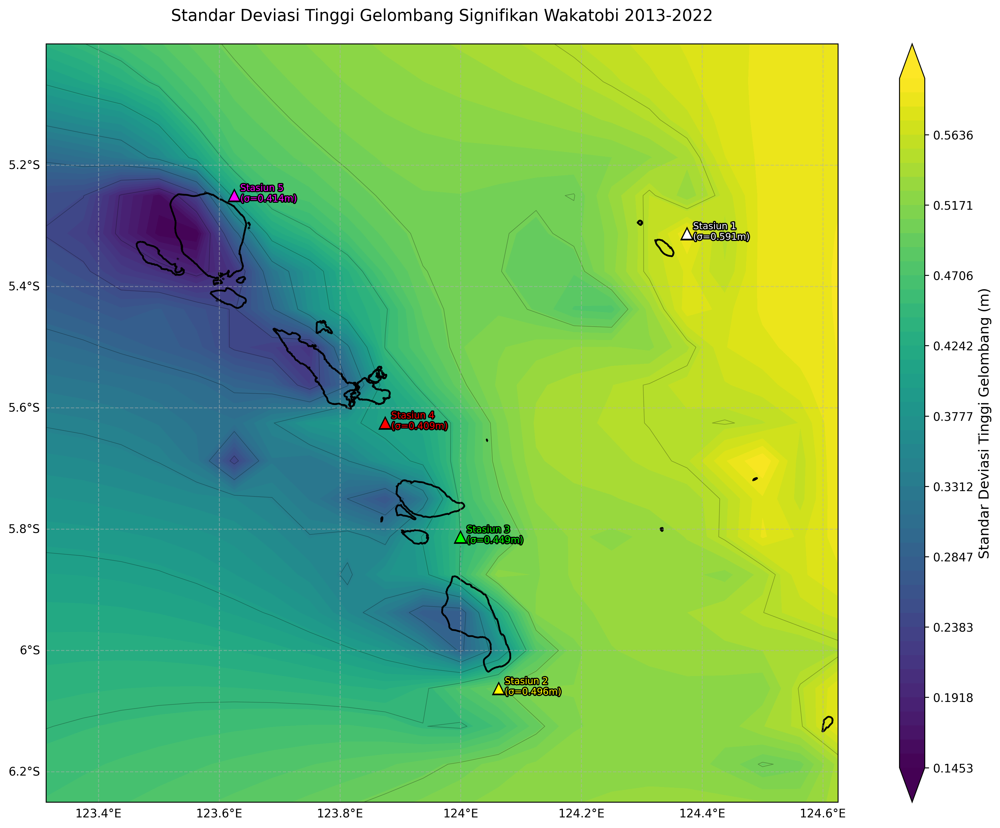

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Baca dataset dan shapefile
ds = xr.open_dataset('/content/drive/MyDrive/data nc/tahunan/combined10tahun.nc')
shapefile_path = '/content/drive/MyDrive/wakatobi'
gdf_wakatobi = gpd.read_file(shapefile_path)

# Koordinat stasiun
coords = [
    (124.375, -5.313, 'Stasiun 1', 0.591),
    (124.063, -6.063, 'Stasiun 2', 0.496),
    (124.000, -5.813, 'Stasiun 3', 0.449),
    (123.875, -5.625, 'Stasiun 4', 0.409),
    (123.625, -5.250, 'Stasiun 5', 0.414)
]

# Hitung standar deviasi untuk seluruh grid
hs_std = ds['hs'].std(dim='time')

# Buat plot
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot data standar deviasi dengan colormap yang lebih sesuai
vmin = np.nanmin(hs_std)
vmax = np.nanmax(hs_std)
levels = np.linspace(vmin, vmax, 50)

# Gunakan colormap yang lebih sesuai untuk standar deviasi
plot = plt.contourf(ds.lon, ds.lat, hs_std,
                   levels=levels,
                   cmap='viridis',  # colormap standar untuk standar deviasi
                   transform=ccrs.PlateCarree(),
                   extend='both')

# Tambahkan kontur garis
plt.contour(ds.lon, ds.lat, hs_std,
           levels=np.linspace(vmin, vmax, 10),
           colors='black',
           alpha=0.3,
           linewidths=0.5,
           transform=ccrs.PlateCarree())

# Plot shapefile Wakatobi dengan transparansi
gdf_wakatobi.plot(ax=ax,
                  edgecolor='black',
                  facecolor='none',  # Membuat area daratan transparan
                  linewidth=1.5,
                  transform=ccrs.PlateCarree())

# Tambahkan gridlines
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Label axis
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Colorbar dengan format yang lebih baik
cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
cbar.set_label('Standar Deviasi Tinggi Gelombang (m)', fontsize=12)
cbar.ax.tick_params(labelsize=10)

# Atur extent peta
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Judul
plt.title('Standar Deviasi Tinggi Gelombang Signifikan Wakatobi 2013-2022',
          pad=20, fontsize=14)

# Plot stasiun dengan warna yang kontras
colors = ['white', 'yellow', 'lime', 'red', 'magenta']
for (lon, lat, label, std), color in zip(coords, colors):
    ax.plot(lon, lat, '^',
            markerfacecolor=color,
            markeredgecolor='black',
            markersize=10,
            transform=ccrs.PlateCarree())
    # Tambahkan label stasiun dan nilai standar deviasi dengan outline putih
    ax.text(lon + 0.01, lat - 0.01,
            f'{label}\n(σ={std:.3f}m)',
            fontsize=8,
            color=color,
            path_effects=[plt.matplotlib.patheffects.withStroke(linewidth=2, foreground='black')],
            transform=ccrs.PlateCarree())

plt.tight_layout()
plt.show()

In [ ]:
import os
import xarray as xr
import numpy as np

# Baca dataset
ds = xr.open_dataset('/content/drive/MyDrive/data nc/tahunan/combined10tahun.nc')

# Koordinat stasiun
coords = [
    (124.375, -5.313, 'Stasiun 1'),
    (124.063, -6.063, 'Stasiun 2'),
    (124.000, -5.813, 'Stasiun 3'),
    (123.875, -5.625, 'Stasiun 4'),
    (123.625, -5.250, 'Stasiun 5')
]

# Fungsi untuk mencari titik grid terdekat
def find_nearest_point(ds, target_lon, target_lat):
    # Mengambil koordinat grid
    lons = ds.lon.values
    lats = ds.lat.values

    # Mencari indeks titik terdekat
    lon_idx = np.abs(lons - target_lon).argmin()
    lat_idx = np.abs(lats - target_lat).argmin()

    return lon_idx, lat_idx

# Hitung standar deviasi untuk setiap stasiun
print("Standar Deviasi Tinggi Gelombang di Setiap Stasiun:")
print("-" * 50)

for lon, lat, nama in coords:
    # Temukan indeks grid terdekat
    lon_idx, lat_idx = find_nearest_point(ds, lon, lat)

    # Ambil data tinggi gelombang untuk titik tersebut
    hs_time_series = ds['hs'].isel(lon=lon_idx, lat=lat_idx)

    # Hitung standar deviasi
    std_dev = float(hs_time_series.std())
    mean_val = float(hs_time_series.mean())

    print(f"{nama}:")
    print(f"Koordinat: {lon}°E, {lat}°S")
    print(f"Standar Deviasi: {std_dev:.3f} meter")
    print(f"Rata-rata: {mean_val:.3f} meter")
    print("-" * 50)

# Hitung statistik keseluruhan
all_std_devs = []
for lon, lat, _ in coords:
    lon_idx, lat_idx = find_nearest_point(ds, lon, lat)
    hs_time_series = ds['hs'].isel(lon=lon_idx, lat=lat_idx)
    all_std_devs.append(float(hs_time_series.std()))

print("\nStatistik Keseluruhan:")
print(f"Rata-rata Standar Deviasi: {np.mean(all_std_devs):.3f} meter")
print(f"Standar Deviasi Minimum: {np.min(all_std_devs):.3f} meter")
print(f"Standar Deviasi Maksimum: {np.max(all_std_devs):.3f} meter")

Standar Deviasi Tinggi Gelombang di Setiap Stasiun:
--------------------------------------------------
Stasiun 1:
Koordinat: 124.375°E, -5.313°S
Standar Deviasi: 0.591 meter
Rata-rata: 0.634 meter
--------------------------------------------------
Stasiun 2:
Koordinat: 124.063°E, -6.063°S
Standar Deviasi: 0.496 meter
Rata-rata: 0.572 meter
--------------------------------------------------
Stasiun 3:
Koordinat: 124.0°E, -5.813°S
Standar Deviasi: 0.449 meter
Rata-rata: 0.502 meter
--------------------------------------------------
Stasiun 4:
Koordinat: 123.875°E, -5.625°S
Standar Deviasi: 0.409 meter
Rata-rata: 0.474 meter
--------------------------------------------------
Stasiun 5:
Koordinat: 123.625°E, -5.25°S
Standar Deviasi: 0.414 meter
Rata-rata: 0.396 meter
--------------------------------------------------

Statistik Keseluruhan:
Rata-rata Standar Deviasi: 0.472 meter
Standar Deviasi Minimum: 0.409 meter
Standar Deviasi Maksimum: 0.591 meter


## **HITUNG JARAK STASIUN DENGAN PULAU TERDEKAT**

Jarak dari Stasiun 1 ke daratan terdekat: 3.90 km
Jarak dari Stasiun 2 ke daratan terdekat: 3.60 km
Jarak dari Stasiun 3 ke daratan terdekat: 4.71 km
Jarak dari Stasiun 4 ke daratan terdekat: 3.58 km
Jarak dari Stasiun 5 ke daratan terdekat: 1.74 km


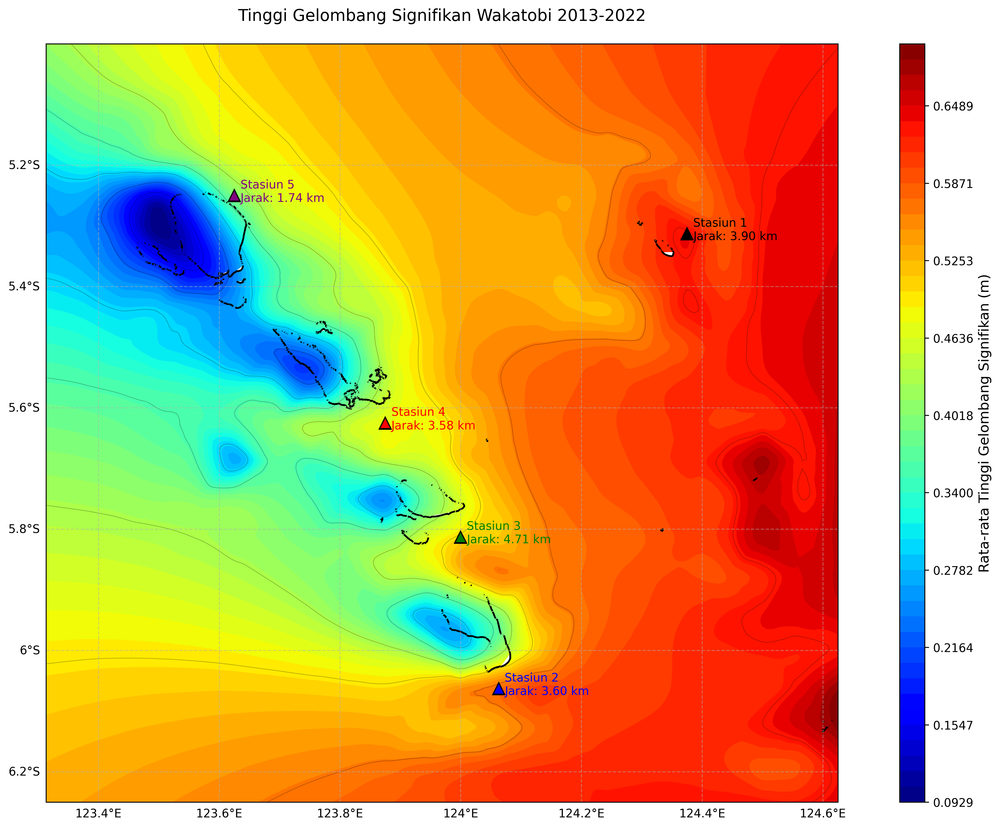

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata
from shapely.geometry import Point
from shapely.ops import nearest_points
from geopy.distance import geodesic

# Buat folder output jika belum ada
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Baca data
shapefile_path = '/content/drive/MyDrive/wakatobi'
ds = xr.open_dataset('/content/drive/MyDrive/data nc/tahunan/combined10tahun.nc')

# Pastikan variabel 'hs' ada dalam dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile Wakatobi, tentukan layer yang ingin dipakai
gdf_wakatobi = gpd.read_file(shapefile_path, layer='GARISRPANTAI_LN_50K')

# Hitung rata-rata tinggi gelombang sepanjang waktu
hs_mean = ds['hs'].mean(dim='time')

# Buat grid untuk interpolasi
lon = ds.lon.values
lat = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon, lat)

# Buat grid yang lebih halus untuk interpolasi
lon_new = np.linspace(lon.min(), lon.max(), 200)
lat_new = np.linspace(lat.min(), lat.max(), 200)
lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

# Interpolasi data
points = np.column_stack((lon_mesh.flatten(), lat_mesh.flatten()))
values = hs_mean.values.flatten()
grid_z = griddata(points, values, (lon_mesh_new, lat_mesh_new), method='cubic')

# Tentukan nilai min dan max
vmin = np.nanmin(grid_z)
vmax = np.nanmax(grid_z)

# Buat plot
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot data tinggi gelombang
plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_z,
                    levels=np.linspace(vmin, vmax, 50),
                    cmap='jet',
                    transform=ccrs.PlateCarree())

# Tambahkan kontur garis
plt.contour(lon_mesh_new, lat_mesh_new, grid_z,
            levels=np.linspace(vmin, vmax, 10),
            colors='black',
            alpha=0.3,
            linewidths=0.5,
            transform=ccrs.PlateCarree())

# Plot shapefile Wakatobi sebagai garis pantai dengan fill warna putih
gdf_wakatobi.plot(ax=ax,
                  edgecolor='black',
                  facecolor='white',
                  linewidth=1.5,
                  transform=ccrs.PlateCarree())

# Tambahkan gridlines dengan label longitude dan latitude
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Tambahkan label untuk Longitude dan Latitude
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Tambahkan colorbar di sebelah kanan
cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
cbar.set_label('Rata-rata Tinggi Gelombang Signifikan (m)', fontsize=12)

# Atur extent peta sesuai dengan gambar yang Anda inginkan
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Tambahkan judul
plt.title('Tinggi Gelombang Signifikan Wakatobi 2013-2022',
          pad=20, fontsize=14)

# Tambahkan simbol lokasi pada koordinat yang ditentukan
coords = [
    (124.375, -5.313, 'Stasiun 1'),
    (124.063, -6.063, 'Stasiun 2'),
    (124.000, -5.813, 'Stasiun 3'),
    (123.875, -5.625, 'Stasiun 4'),
    (123.625, -5.250, 'Stasiun 5')
]

# Daftar warna untuk setiap stasiun
colors = ['black', 'blue', 'green', 'red', 'purple']

# Fungsi untuk menghitung jarak terdekat dari setiap titik ke daratan di shapefile
def calculate_nearest_distance(point, gdf):
    # Temukan titik pada daratan terdekat
    nearest_geom = nearest_points(point, gdf.geometry.union_all())[1]
    # Hitung jarak geodesik (menggunakan geopy untuk hasil dalam kilometer)
    return geodesic((point.y, point.x), (nearest_geom.y, nearest_geom.x)).km

# Hitung jarak dan plot titik serta label stasiun
for (lon, lat, label), color in zip(coords, colors):
    point = Point(lon, lat)
    distance = calculate_nearest_distance(point, gdf_wakatobi)

    # Plot titik pada peta
    ax.plot(lon, lat, '^', markerfacecolor=color, markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())

    # Plot label stasiun dan jarak ke daratan terdekat
    ax.text(lon + 0.01, lat - 0.01, f"{label}\nJarak: {distance:.2f} km", fontsize=10, color=color, transform=ccrs.PlateCarree())  # Offset teks sedikit dari titik

    # Cetak hasil jarak di output
    print(f"Jarak dari {label} ke daratan terdekat: {distance:.2f} km")

plt.tight_layout()
plt.show()


In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from shapely.geometry import Point
from shapely.ops import unary_union
from scipy.interpolate import griddata
import pandas as pd

# Set output folder
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Load dataset
ds = xr.open_dataset('/content/drive/MyDrive/data nc/tahunan/combined10tahun.nc')

# Pastikan variabel 'hs' dan 'dir' ada di dataset
if 'hs' not in ds or 'dir' not in ds:
    raise ValueError("Variabel 'hs' atau 'dir' tidak ditemukan di dataset.")

# Load shapefile Wakatobi dan pilih layer yang berisi batas wilayah laut
shapefile_path = '/content/drive/MyDrive/wakatobi'
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')

# Handle time dimension and create month information
time_values = pd.to_datetime(ds.time.values)
months = time_values.month

# Define seasonal ranges in terms of month numbers
seasons = {
    "Musim Barat": [12, 1, 2],
    "Peralihan 1": [3, 4, 5],
    "Musim Timur": [6, 7, 8],
    "Peralihan 2": [9, 10, 11]
}

# Set interpolation level
interpolation_level = 500

# Masking dengan shapefile
ocean_mask = unary_union([geom for geom in gdf_wakatobi.geometry if geom.is_valid])

# Loop through each season
for season, season_months in seasons.items():
    print(f"Processing {season}...")

    # Create boolean mask for the current season
    season_mask = np.isin(months, season_months)

    # Calculate seasonal averages directly using the mask
    hs_mean = ds['hs'].isel(time=season_mask).mean('time')
    dir_mean = ds['dir'].isel(time=season_mask).mean('time')

    if np.all(np.isnan(hs_mean)) or np.all(np.isnan(dir_mean)):
        print(f"No valid data found for {season}")
        continue

    # Koordinat grid asli
    lon_array = ds.lon.values
    lat_array = ds.lat.values
    lon_mesh, lat_mesh = np.meshgrid(lon_array, lat_array)

    # Grid baru untuk interpolasi
    lon_new = np.linspace(lon_array.min(), lon_array.max(), interpolation_level)
    lat_new = np.linspace(lat_array.min(), lat_array.max(), interpolation_level)
    lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

    # Buat mask untuk laut berdasarkan shapefile
    mask = np.array([
        ocean_mask.contains(Point(lon, lat))
        for lon, lat in zip(lon_mesh_new.ravel(), lat_mesh_new.ravel())
    ]).reshape(lon_mesh_new.shape)

    # Pembalikan mask agar hanya laut yang memiliki nilai
    mask = ~mask

    # Interpolasi cubic untuk 'hs' dan 'dir'
    grid_hs = griddata(
        (lon_mesh.flatten(), lat_mesh.flatten()), hs_mean.values.flatten(),
        (lon_mesh_new, lat_mesh_new), method='cubic'
    )
    grid_dir = griddata(
        (lon_mesh.flatten(), lat_mesh.flatten()), dir_mean.values.flatten(),
        (lon_mesh_new, lat_mesh_new), method='cubic'
    )

    # Terapkan mask pada data interpolasi
    grid_hs[~mask] = np.nan
    grid_dir[~mask] = np.nan

    # Batas nilai plot
    vmin = np.nanmin(grid_hs)
    vmax = np.nanmax(grid_hs)

    # Plotting
    plt.figure(figsize=(15, 10), dpi=300)
    ax = plt.axes(projection=ccrs.PlateCarree())

    # Plotting data tinggi gelombang yang sudah diinterpolasi
    plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_hs,
                        levels=np.linspace(vmin, vmax, 50),
                        cmap='jet', transform=ccrs.PlateCarree())

    # Garis kontur
    plt.contour(lon_mesh_new, lat_mesh_new, grid_hs,
                levels=np.linspace(vmin, vmax, 10),
                colors='black', alpha=0.3,
                linewidths=0.5, transform=ccrs.PlateCarree())

    # Overlay data arah penjalaran gelombang (vector field)
    stride = 20  # Mengatur jarak antar vektor
    plt.quiver(
        lon_mesh_new[::stride, ::stride], lat_mesh_new[::stride, ::stride],
        np.cos(np.deg2rad(grid_dir[::stride, ::stride])),  # Komponen U
        np.sin(np.deg2rad(grid_dir[::stride, ::stride])),  # Komponen V
        scale=50, color='white', transform=ccrs.PlateCarree()
    )

    # Plot batas shapefile Wakatobi
    gdf_wakatobi.plot(ax=ax, edgecolor='black', facecolor='gray', linewidth=1.5, transform=ccrs.PlateCarree())

    # Garis grid dengan label
    gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
    gl.top_labels = False
    gl.right_labels = False

    # Label sumbu
    ax.set_xlabel('Longitude (°E)', fontsize=12)
    ax.set_ylabel('Latitude (°S)', fontsize=12)

    # Warna untuk baris warna
    cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
    cbar.set_label(f'Rata-rata Tinggi Gelombang Signifikan (m) - {season}', fontsize=12)

    # Set batas peta
    ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

    # Judul
    plt.title(f'Tinggi Gelombang Signifikan Wakatobi 2013-2022 - {season} (Cubic Interpolasi)',
              pad=20, fontsize=14)

    # Simbol stasiun dan label
    coords = [
        (124.375, -5.313, 'Stasiun 1'),
        (124.063, -6.063, 'Stasiun 2'),
        (124.000, -5.813, 'Stasiun 3'),
        (123.875, -5.625, 'Stasiun 4'),
        (123.625, -5.250, 'Stasiun 5')
    ]
    colors = ['black', 'blue', 'green', 'red', 'purple']

    for (lon, lat, label), color in zip(coords, colors):
        ax.plot(lon, lat, '^', markerfacecolor=color, markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())
        ax.text(lon + 0.01, lat - 0.01, label, fontsize=10, color=color, transform=ccrs.PlateCarree())

    plt.tight_layout()

    # Save plot
    output_path = os.path.join(output_folder, f'wave_analysis_{season.lower().replace(" ", "_")}.png')
    plt.savefig(output_path, dpi=300, bbox_inches='tight')
    plt.close()

    print(f"Plot saved for {season}")

Processing Musim Barat...


AttributeError: 'ScipyArrayWrapper' object has no attribute 'oindex'

## **PLOT HS MUSIM BARAT**

/usr/local/lib/python3.10/dist-packages/pyogrio/geopandas.py:265: UserWarning: More than one layer found in 'wakatobi': 'ADMINISTRASIKABKOTA_AR_50K' (default), 'ADMINISTRASIKECAMATAN_AR_50K', 'AGRIKEBUN_AR_50K', 'ADMINISTRASIKECAMATAN_LN_50K', 'AGRILADANG_AR_50K', 'BANGUNAN_PT_50K', 'AGRITANAMCAMPUR_AR_50K', 'BETING_LN_50K', 'DANAU_AR_50K', 'DERMAGA_PT_50K', 'DERMAGA_LN_50K', 'EMPANG_AR_50K', 'JALAN_LN_50K', 'GARISRPANTAI_LN_50K', 'JEMBATAN_PT_50K', 'MAKAM_PT_50K', 'KONTUR_LN_50K', 'NONAGRIHUTANKERING_AR_50K', 'NONAGRIALANG_AR_50K', 'NONAGRIHUTANBASAH_AR_50K', 'NONAGRISEMAKBELUKAR_AR_50K', 'PEMERINTAHAN_PT_50K', 'PASIR_AR_50K', 'RAWA_AR_50K', 'PEMUKIMAN_AR_50K', 'PESISIR_AR_50K', 'SARANAIBADAH_PT_50K', 'SUNGAI_LN_50K', 'SPOTHEIGHT_PT_50K', 'TOPONIMI_PT_50K', 'TAMBANGAN_PT_50K', 'titik WW3'. Specify layer parameter to avoid this warning.
  result = read_func(


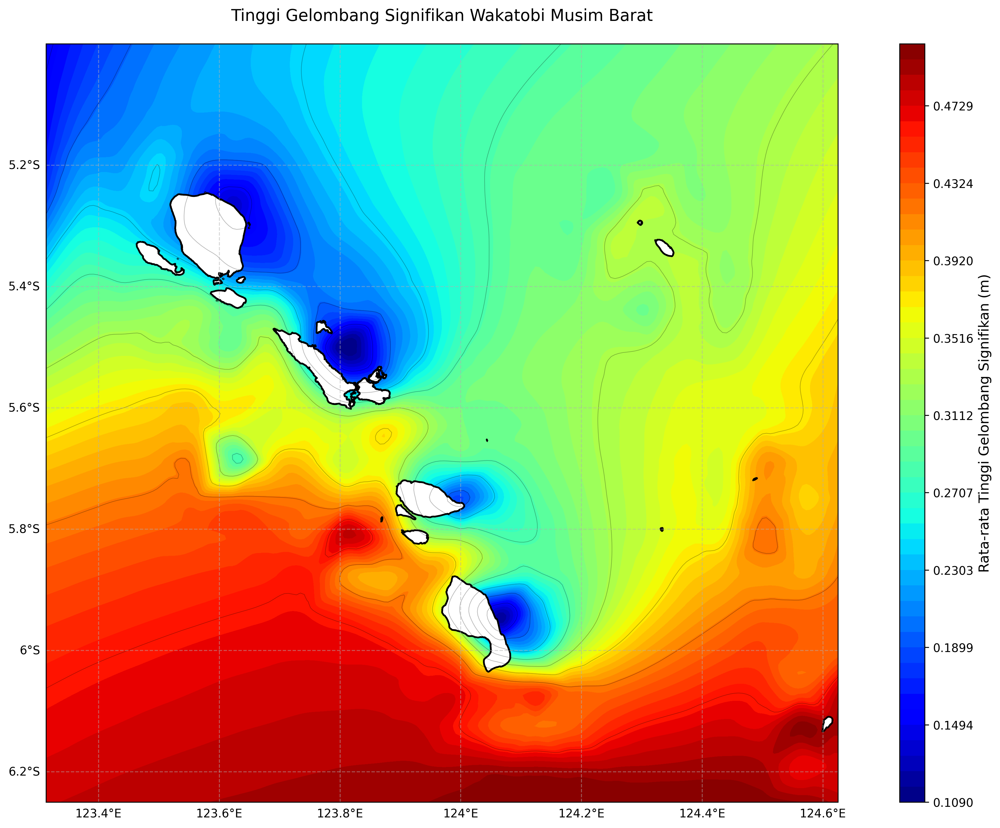

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
!pip install cartopy
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Buat folder output jika belum ada
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Baca data
shapefile_path = '/content/drive/MyDrive/wakatobi'
ds = xr.open_dataset('/content/drive/MyDrive/data nc/musiman/kombinasi_musimbarat.nc')

# Pastikan variabel 'hs' ada dalam dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path)

# Hitung rata-rata tinggi gelombang sepanjang waktu
hs_mean = ds['hs'].mean(dim='time')

# Buat grid untuk interpolasi
lon = ds.lon.values
lat = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon, lat)

# Buat grid yang lebih halus untuk interpolasi
lon_new = np.linspace(lon.min(), lon.max(), 200)
lat_new = np.linspace(lat.min(), lat.max(), 200)
lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

# Interpolasi data
points = np.column_stack((lon_mesh.flatten(), lat_mesh.flatten()))
values = hs_mean.values.flatten()
grid_z = griddata(points, values, (lon_mesh_new, lat_mesh_new), method='cubic')

# Tentukan nilai min dan max
vmin = np.nanmin(grid_z)
vmax = np.nanmax(grid_z)

# Buat plot
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot data tinggi gelombang
plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_z,
                    levels=np.linspace(vmin, vmax, 50),
                    cmap='jet',
                    transform=ccrs.PlateCarree())

# Tambahkan kontur garis
plt.contour(lon_mesh_new, lat_mesh_new, grid_z,
            levels=np.linspace(vmin, vmax, 10),
            colors='black',
            alpha=0.3,
            linewidths=0.5,
            transform=ccrs.PlateCarree())

# Plot shapefile Wakatobi sebagai garis pantai dengan fill warna putih
gdf_wakatobi.plot(ax=ax,
                  edgecolor='black',
                  facecolor='white',
                  linewidth=1.5,
                  transform=ccrs.PlateCarree())

# Tambahkan gridlines dengan label longitude dan latitude
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Tambahkan label untuk Longitude dan Latitude
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Tambahkan colorbar di sebelah kanan
cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
cbar.set_label('Rata-rata Tinggi Gelombang Signifikan (m)', fontsize=12)

# Atur extent peta sesuai dengan gambar yang Anda inginkan
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Tambahkan judul
plt.title('Tinggi Gelombang Signifikan Wakatobi Musim Barat',
          pad=20, fontsize=14)

# Hapus bagian yang menambahkan simbol lokasi
# coords = [
#     (124.375, -5.313),
#     (124.063, -6.063),
#     (124, -5.813),
#     (123.875, -5.625),
#     (123.625, -5.25)
# ]

# for lon, lat in coords:
#     ax.plot(lon, lat, '^', markerfacecolor='black', markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())

plt.tight_layout()
plt.show()


## **PLOT HS MUSIM PERALIHAN 1**

/usr/local/lib/python3.10/dist-packages/pyogrio/geopandas.py:265: UserWarning: More than one layer found in 'wakatobi': 'ADMINISTRASIKABKOTA_AR_50K' (default), 'ADMINISTRASIKECAMATAN_AR_50K', 'AGRIKEBUN_AR_50K', 'ADMINISTRASIKECAMATAN_LN_50K', 'AGRILADANG_AR_50K', 'BANGUNAN_PT_50K', 'AGRITANAMCAMPUR_AR_50K', 'BETING_LN_50K', 'DANAU_AR_50K', 'DERMAGA_PT_50K', 'DERMAGA_LN_50K', 'EMPANG_AR_50K', 'JALAN_LN_50K', 'GARISRPANTAI_LN_50K', 'JEMBATAN_PT_50K', 'MAKAM_PT_50K', 'KONTUR_LN_50K', 'NONAGRIHUTANKERING_AR_50K', 'NONAGRIALANG_AR_50K', 'NONAGRIHUTANBASAH_AR_50K', 'NONAGRISEMAKBELUKAR_AR_50K', 'PEMERINTAHAN_PT_50K', 'PASIR_AR_50K', 'RAWA_AR_50K', 'PEMUKIMAN_AR_50K', 'PESISIR_AR_50K', 'SARANAIBADAH_PT_50K', 'SUNGAI_LN_50K', 'SPOTHEIGHT_PT_50K', 'TOPONIMI_PT_50K', 'TAMBANGAN_PT_50K', 'titik WW3'. Specify layer parameter to avoid this warning.
  result = read_func(


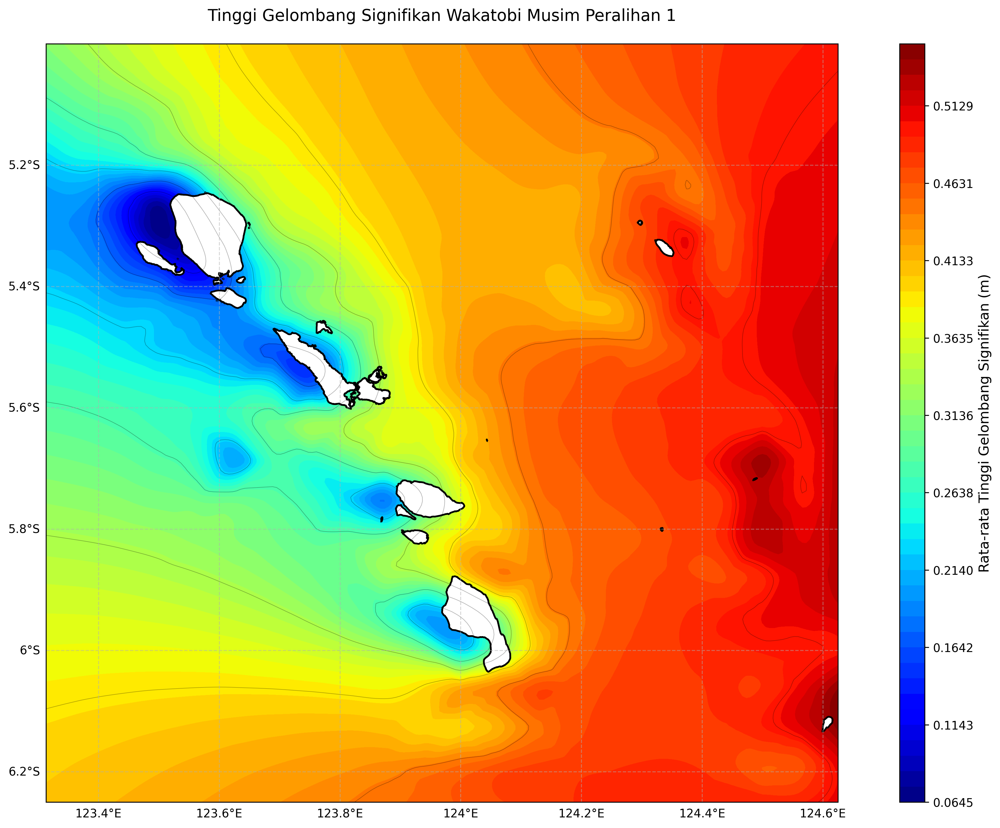

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
!pip install cartopy
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Buat folder output jika belum ada
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Baca data
shapefile_path = '/content/drive/MyDrive/wakatobi'
ds = xr.open_dataset('/content/drive/MyDrive/data nc/musiman/kombinasi_musimperalihan1.nc')

# Pastikan variabel 'hs' ada dalam dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path)

# Hitung rata-rata tinggi gelombang sepanjang waktu
hs_mean = ds['hs'].mean(dim='time')

# Buat grid untuk interpolasi
lon = ds.lon.values
lat = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon, lat)

# Buat grid yang lebih halus untuk interpolasi
lon_new = np.linspace(lon.min(), lon.max(), 200)
lat_new = np.linspace(lat.min(), lat.max(), 200)
lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

# Interpolasi data
points = np.column_stack((lon_mesh.flatten(), lat_mesh.flatten()))
values = hs_mean.values.flatten()
grid_z = griddata(points, values, (lon_mesh_new, lat_mesh_new), method='cubic')

# Tentukan nilai min dan max
vmin = np.nanmin(grid_z)
vmax = np.nanmax(grid_z)

# Buat plot
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot data tinggi gelombang
plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_z,
                    levels=np.linspace(vmin, vmax, 50),
                    cmap='jet',
                    transform=ccrs.PlateCarree())

# Tambahkan kontur garis
plt.contour(lon_mesh_new, lat_mesh_new, grid_z,
            levels=np.linspace(vmin, vmax, 10),
            colors='black',
            alpha=0.3,
            linewidths=0.5,
            transform=ccrs.PlateCarree())

# Plot shapefile Wakatobi sebagai garis pantai dengan fill warna putih
gdf_wakatobi.plot(ax=ax,
                  edgecolor='black',
                  facecolor='white',
                  linewidth=1.5,
                  transform=ccrs.PlateCarree())

# Tambahkan gridlines dengan label longitude dan latitude
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Tambahkan label untuk Longitude dan Latitude
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Tambahkan colorbar di sebelah kanan
cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
cbar.set_label('Rata-rata Tinggi Gelombang Signifikan (m)', fontsize=12)

# Atur extent peta sesuai dengan gambar yang Anda inginkan
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Tambahkan judul
plt.title('Tinggi Gelombang Signifikan Wakatobi Musim Peralihan 1',
          pad=20, fontsize=14)

# Hapus bagian yang menambahkan simbol lokasi
# coords = [
#     (124.375, -5.313),
#     (124.063, -6.063),
#     (124, -5.813),
#     (123.875, -5.625),
#     (123.625, -5.25)
# ]

# for lon, lat in coords:
#     ax.plot(lon, lat, '^', markerfacecolor='black', markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())

plt.tight_layout()
plt.show()


## **PLOT HS MUSIM PERALIHAN 2**

/usr/local/lib/python3.10/dist-packages/pyogrio/geopandas.py:265: UserWarning: More than one layer found in 'wakatobi': 'ADMINISTRASIKABKOTA_AR_50K' (default), 'ADMINISTRASIKECAMATAN_AR_50K', 'AGRIKEBUN_AR_50K', 'ADMINISTRASIKECAMATAN_LN_50K', 'AGRILADANG_AR_50K', 'BANGUNAN_PT_50K', 'AGRITANAMCAMPUR_AR_50K', 'BETING_LN_50K', 'DANAU_AR_50K', 'DERMAGA_PT_50K', 'DERMAGA_LN_50K', 'EMPANG_AR_50K', 'JALAN_LN_50K', 'GARISRPANTAI_LN_50K', 'JEMBATAN_PT_50K', 'MAKAM_PT_50K', 'KONTUR_LN_50K', 'NONAGRIHUTANKERING_AR_50K', 'NONAGRIALANG_AR_50K', 'NONAGRIHUTANBASAH_AR_50K', 'NONAGRISEMAKBELUKAR_AR_50K', 'PEMERINTAHAN_PT_50K', 'PASIR_AR_50K', 'RAWA_AR_50K', 'PEMUKIMAN_AR_50K', 'PESISIR_AR_50K', 'SARANAIBADAH_PT_50K', 'SUNGAI_LN_50K', 'SPOTHEIGHT_PT_50K', 'TOPONIMI_PT_50K', 'TAMBANGAN_PT_50K', 'titik WW3'. Specify layer parameter to avoid this warning.
  result = read_func(


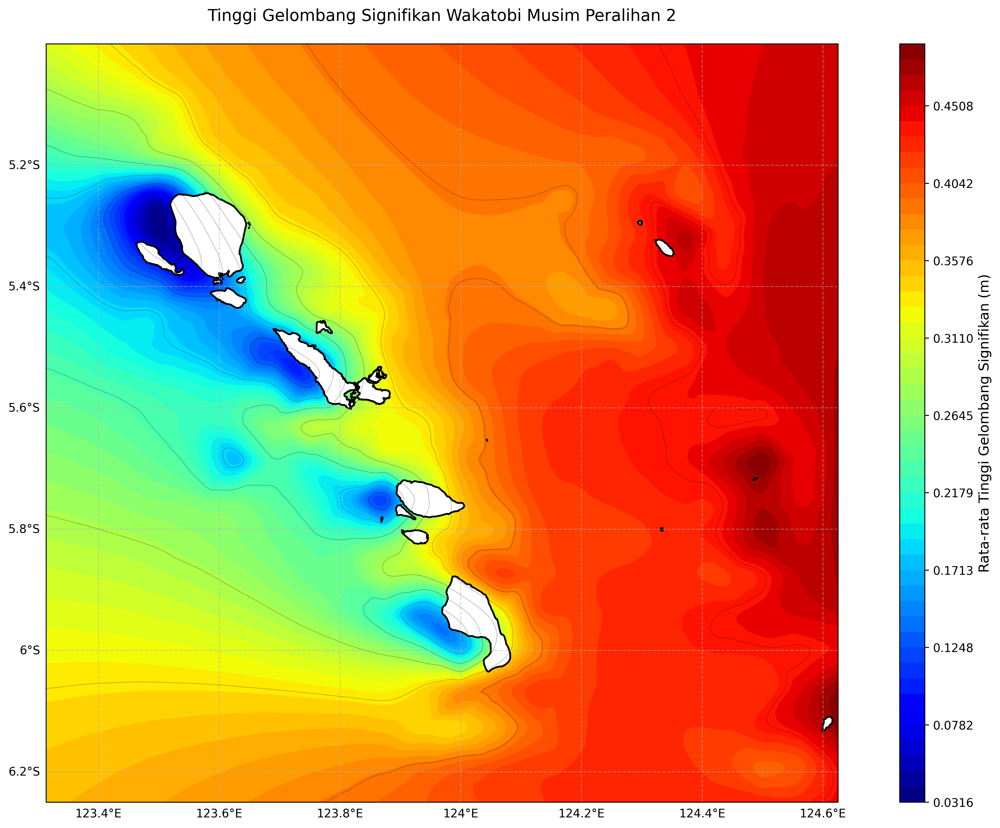

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
!pip install cartopy
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Buat folder output jika belum ada
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Baca data
shapefile_path = '/content/drive/MyDrive/wakatobi'
ds = xr.open_dataset('/content/drive/MyDrive/data nc/musiman/kombinasi_musimperalihan2.nc')

# Pastikan variabel 'hs' ada dalam dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path)

# Hitung rata-rata tinggi gelombang sepanjang waktu
hs_mean = ds['hs'].mean(dim='time')

# Buat grid untuk interpolasi
lon = ds.lon.values
lat = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon, lat)

# Buat grid yang lebih halus untuk interpolasi
lon_new = np.linspace(lon.min(), lon.max(), 200)
lat_new = np.linspace(lat.min(), lat.max(), 200)
lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

# Interpolasi data
points = np.column_stack((lon_mesh.flatten(), lat_mesh.flatten()))
values = hs_mean.values.flatten()
grid_z = griddata(points, values, (lon_mesh_new, lat_mesh_new), method='cubic')

# Tentukan nilai min dan max
vmin = np.nanmin(grid_z)
vmax = np.nanmax(grid_z)

# Buat plot
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot data tinggi gelombang
plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_z,
                    levels=np.linspace(vmin, vmax, 50),
                    cmap='jet',
                    transform=ccrs.PlateCarree())

# Tambahkan kontur garis
plt.contour(lon_mesh_new, lat_mesh_new, grid_z,
            levels=np.linspace(vmin, vmax, 10),
            colors='black',
            alpha=0.3,
            linewidths=0.5,
            transform=ccrs.PlateCarree())

# Plot shapefile Wakatobi sebagai garis pantai dengan fill warna putih
gdf_wakatobi.plot(ax=ax,
                  edgecolor='black',
                  facecolor='white',
                  linewidth=1.5,
                  transform=ccrs.PlateCarree())

# Tambahkan gridlines dengan label longitude dan latitude
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Tambahkan label untuk Longitude dan Latitude
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Tambahkan colorbar di sebelah kanan
cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
cbar.set_label('Rata-rata Tinggi Gelombang Signifikan (m)', fontsize=12)

# Atur extent peta sesuai dengan gambar yang Anda inginkan
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Tambahkan judul
plt.title('Tinggi Gelombang Signifikan Wakatobi Musim Peralihan 2',
          pad=20, fontsize=14)

# Hapus bagian yang menambahkan simbol lokasi
# coords = [
#     (124.375, -5.313),
#     (124.063, -6.063),
#     (124, -5.813),
#     (123.875, -5.625),
#     (123.625, -5.25)
# ]

# for lon, lat in coords:
#     ax.plot(lon, lat, '^', markerfacecolor='black', markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())

plt.tight_layout()
plt.show()


## **PLOT HS MUSIM TIMUR**

/usr/local/lib/python3.10/dist-packages/pyogrio/geopandas.py:265: UserWarning: More than one layer found in 'wakatobi': 'ADMINISTRASIKABKOTA_AR_50K' (default), 'ADMINISTRASIKECAMATAN_AR_50K', 'AGRIKEBUN_AR_50K', 'ADMINISTRASIKECAMATAN_LN_50K', 'AGRILADANG_AR_50K', 'BANGUNAN_PT_50K', 'AGRITANAMCAMPUR_AR_50K', 'BETING_LN_50K', 'DANAU_AR_50K', 'DERMAGA_PT_50K', 'DERMAGA_LN_50K', 'EMPANG_AR_50K', 'JALAN_LN_50K', 'GARISRPANTAI_LN_50K', 'JEMBATAN_PT_50K', 'MAKAM_PT_50K', 'KONTUR_LN_50K', 'NONAGRIHUTANKERING_AR_50K', 'NONAGRIALANG_AR_50K', 'NONAGRIHUTANBASAH_AR_50K', 'NONAGRISEMAKBELUKAR_AR_50K', 'PEMERINTAHAN_PT_50K', 'PASIR_AR_50K', 'RAWA_AR_50K', 'PEMUKIMAN_AR_50K', 'PESISIR_AR_50K', 'SARANAIBADAH_PT_50K', 'SUNGAI_LN_50K', 'SPOTHEIGHT_PT_50K', 'TOPONIMI_PT_50K', 'TAMBANGAN_PT_50K', 'titik WW3'. Specify layer parameter to avoid this warning.
  result = read_func(


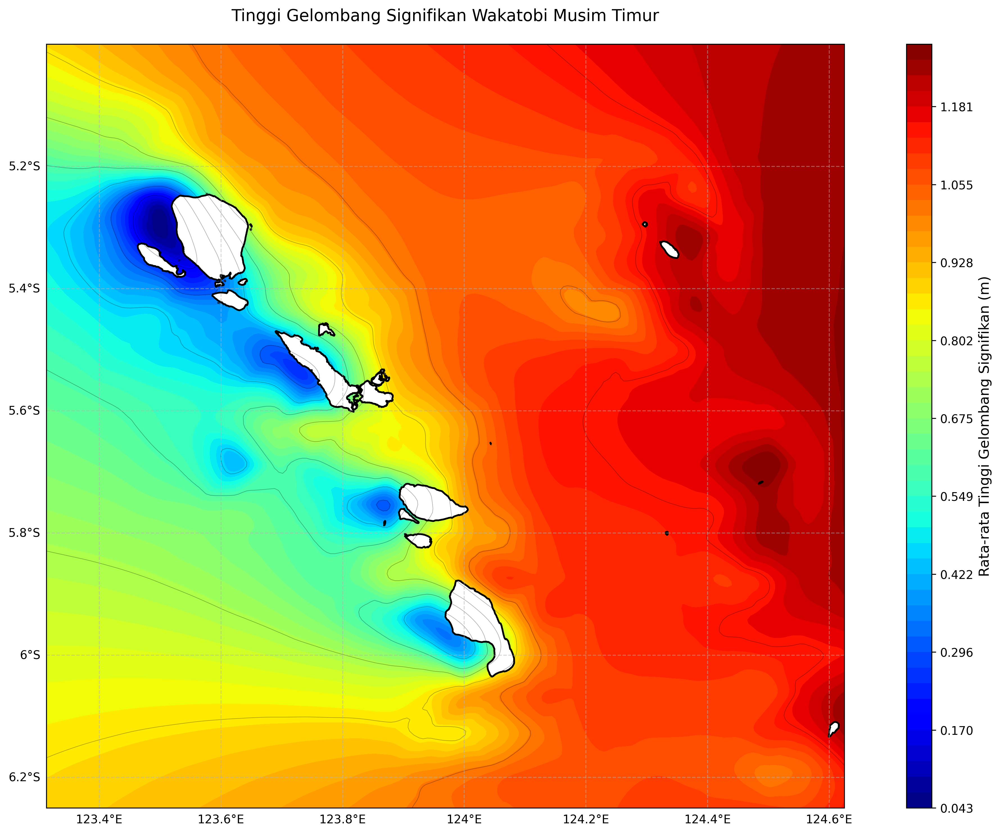

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
!pip install cartopy
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Buat folder output jika belum ada
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Baca data
shapefile_path = '/content/drive/MyDrive/wakatobi'
ds = xr.open_dataset('/content/drive/MyDrive/data nc/musiman/kombinasi_musimtimur.nc')

# Pastikan variabel 'hs' ada dalam dataset
if 'hs' not in ds:
    raise ValueError("Variabel 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path)

# Hitung rata-rata tinggi gelombang sepanjang waktu
hs_mean = ds['hs'].mean(dim='time')

# Buat grid untuk interpolasi
lon = ds.lon.values
lat = ds.lat.values
lon_mesh, lat_mesh = np.meshgrid(lon, lat)

# Buat grid yang lebih halus untuk interpolasi
lon_new = np.linspace(lon.min(), lon.max(), 200)
lat_new = np.linspace(lat.min(), lat.max(), 200)
lon_mesh_new, lat_mesh_new = np.meshgrid(lon_new, lat_new)

# Interpolasi data
points = np.column_stack((lon_mesh.flatten(), lat_mesh.flatten()))
values = hs_mean.values.flatten()
grid_z = griddata(points, values, (lon_mesh_new, lat_mesh_new), method='cubic')

# Tentukan nilai min dan max
vmin = np.nanmin(grid_z)
vmax = np.nanmax(grid_z)

# Buat plot
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot data tinggi gelombang
plot = plt.contourf(lon_mesh_new, lat_mesh_new, grid_z,
                    levels=np.linspace(vmin, vmax, 50),
                    cmap='jet',
                    transform=ccrs.PlateCarree())

# Tambahkan kontur garis
plt.contour(lon_mesh_new, lat_mesh_new, grid_z,
            levels=np.linspace(vmin, vmax, 10),
            colors='black',
            alpha=0.3,
            linewidths=0.5,
            transform=ccrs.PlateCarree())

# Plot shapefile Wakatobi sebagai garis pantai dengan fill warna putih
gdf_wakatobi.plot(ax=ax,
                  edgecolor='black',
                  facecolor='white',
                  linewidth=1.5,
                  transform=ccrs.PlateCarree())

# Tambahkan gridlines dengan label longitude dan latitude
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Tambahkan label untuk Longitude dan Latitude
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Tambahkan colorbar di sebelah kanan
cbar = plt.colorbar(plot, orientation='vertical', pad=0.05, aspect=30)
cbar.set_label('Rata-rata Tinggi Gelombang Signifikan (m)', fontsize=12)

# Atur extent peta sesuai dengan gambar yang Anda inginkan
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Tambahkan judul
plt.title('Tinggi Gelombang Signifikan Wakatobi Musim Timur',
          pad=20, fontsize=14)

# Hapus bagian yang menambahkan simbol lokasi
# coords = [
#     (124.375, -5.313),
#     (124.063, -6.063),
#     (124, -5.813),
#     (123.875, -5.625),
#     (123.625, -5.25)
# ]

# for lon, lat in coords:
#     ax.plot(lon, lat, '^', markerfacecolor='black', markeredgecolor='black', markersize=10, transform=ccrs.PlateCarree())

plt.tight_layout()
plt.show()


In [ ]:
import os
import xarray as xr

# Baca dataset NetCDF
dataset_path = '/content/drive/MyDrive/data nc/tahunan/combined10tahun.nc'
ds = xr.open_dataset(dataset_path)

# Daftar koordinat lokasi
coords = [
    (124.375, -5.313),
    (124.063, -6.063),
    (124.0, -5.813),
    (123.875, -5.625),
    (123.625, -5.25)
]

# Fungsi untuk mengambil data pada titik koordinat tertentu
def extract_data_at_point(ds, lon, lat):
    # Interpolasi data di titik yang mendekati koordinat lon, lat
    point_data = ds.sel(lon=lon, lat=lat, method='nearest')
    point_data = point_data.expand_dims({"Longitude": [lon], "Latitude": [lat]})
    return point_data

# Inisialisasi dataset kosong untuk menyimpan semua data dari lima titik
all_points_data = []

# Loop untuk setiap titik koordinat
for lon, lat in coords:
    # Ambil data untuk titik saat ini dan tambahkan ke list
    point_data = extract_data_at_point(ds, lon, lat)
    all_points_data.append(point_data)

# Gabungkan semua data dari lima titik menjadi satu dataset
all_points_ds = xr.concat(all_points_data, dim="points")
all_points_ds = all_points_ds.assign_coords({"points": ["Point_1", "Point_2", "Point_3", "Point_4", "Point_5"]})

# Simpan dataset ke file NetCDF baru
output_path = '/content/drive/MyDrive/output/raw_wave_data_10years_points.nc'
all_points_ds.to_netcdf(output_path)

print(f"Data mentah dari lima titik koordinat telah disimpan ke {output_path}")


Data mentah dari lima titik koordinat telah disimpan ke /content/drive/MyDrive/output/raw_wave_data_10years_points.nc


In [ ]:
import os
import xarray as xr
import numpy as np

# Baca dataset NetCDF asli
dataset_path = '/content/drive/MyDrive/data nc/tahunan/combined10tahun.nc'
ds = xr.open_dataset(dataset_path)

# Daftar koordinat untuk lima titik
coords = [
    (124.375, -5.313),
    (124.063, -6.063),
    (124.0, -5.813),
    (123.875, -5.625),
    (123.625, -5.25)
]

# Fungsi untuk mengambil data pada titik koordinat tertentu
def extract_data_at_point(ds, lon, lat):
    # Interpolasi data di titik yang mendekati koordinat lon, lat
    point_data = ds.sel(lon=lon, lat=lat, method='nearest')
    return point_data

# Ambil data untuk kelima titik koordinat dan simpan dalam list
all_points_data = []
lon_list, lat_list = [], []

for lon, lat in coords:
    point_data = extract_data_at_point(ds, lon, lat)
    point_data = point_data.expand_dims("points")  # Tambahkan dimensi "points"
    lon_list.append(lon)
    lat_list.append(lat)
    all_points_data.append(point_data)

# Gabungkan semua data dari kelima titik menjadi satu dataset dengan dimensi points
all_points_ds = xr.concat(all_points_data, dim="points")

# Tambahkan koordinat lon dan lat ke dimensi points
all_points_ds = all_points_ds.assign_coords(points=("points", list(range(len(coords)))))
all_points_ds = all_points_ds.assign_coords(lon=("points", lon_list))
all_points_ds = all_points_ds.assign_coords(lat=("points", lat_list))

# Simpan dataset gabungan ke file NetCDF baru
output_path = '/content/drive/MyDrive/output/raw_wave_data_10years_points13.nc'
all_points_ds.to_netcdf(output_path)

print(f"Data mentah dari lima titik koordinat telah disimpan ke {output_path}")

# Buka dataset dan tampilkan informasi variabel dan jumlah data di setiap variabel
print("\nInformasi Variabel dan Jumlah Data:")
for var_name in all_points_ds.data_vars:
    var_data = all_points_ds[var_name]
    print(f"Variabel: {var_name}, Dimensi: {var_data.dims}, Jumlah Data: {var_data.size}")

# Tampilkan informasi jumlah data di tiap koordinat (lon, lat)
print("\nJumlah Data di Setiap Koordinat:")
for i, (lon, lat) in enumerate(coords):
    print(f"Koordinat ({lon}, {lat}):")
    for var_name in all_points_ds.data_vars:
        var_data = all_points_ds[var_name].isel(points=i)
        print(f"  - {var_name}: {var_data.size} data points")

print("\nInformasi Detail Dataset:")
print(all_points_ds)


Data mentah dari lima titik koordinat telah disimpan ke /content/drive/MyDrive/output/raw_wave_data_10years_points13.nc

Informasi Variabel dan Jumlah Data:
Variabel: hs, Dimensi: ('points', 'time'), Jumlah Data: 144820
Variabel: t01, Dimensi: ('points', 'time'), Jumlah Data: 144820
Variabel: dir, Dimensi: ('points', 'time'), Jumlah Data: 144820

Jumlah Data di Setiap Koordinat:
Koordinat (124.375, -5.313):
  - hs: 28964 data points
  - t01: 28964 data points
  - dir: 28964 data points
Koordinat (124.063, -6.063):
  - hs: 28964 data points
  - t01: 28964 data points
  - dir: 28964 data points
Koordinat (124.0, -5.813):
  - hs: 28964 data points
  - t01: 28964 data points
  - dir: 28964 data points
Koordinat (123.875, -5.625):
  - hs: 28964 data points
  - t01: 28964 data points
  - dir: 28964 data points
Koordinat (123.625, -5.25):
  - hs: 28964 data points
  - t01: 28964 data points
  - dir: 28964 data points

Informasi Detail Dataset:
<xarray.Dataset> Size: 2MB
Dimensions:  (points: 

## **PLOT HS DAN ARAH GELOMBANG**

# **musim peralihan 1**

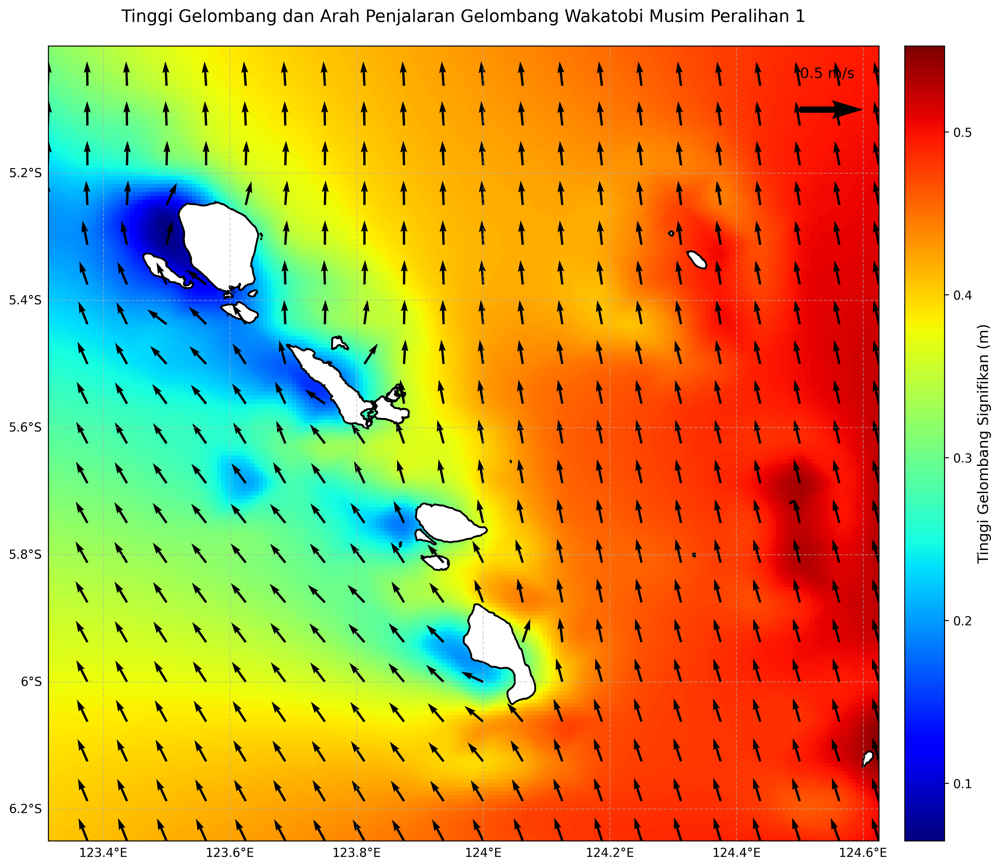

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Buat folder output jika belum ada
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Baca data
shapefile_path = '/content/drive/MyDrive/wakatobi'
ds = xr.open_dataset('/content/drive/MyDrive/data nc/musiman/kombinasi_musimperalihan1.nc')

# Pastikan variabel 'dir' dan 'hs' ada dalam dataset
if 'dir' not in ds or 'hs' not in ds:
    raise ValueError("Variabel 'dir' atau 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')

# Hitung rata-rata arah dan tinggi gelombang sepanjang waktu
dir_mean = ds['dir'].mean(dim='time')
hs_mean = ds['hs'].mean(dim='time')

# Pastikan data longitude dan latitude dalam bentuk yang sama (2D)
lon = ds.lon.values
lat = ds.lat.values
hs_values = hs_mean.values

if lon.ndim == 1 and lat.ndim == 1:
    lon, lat = np.meshgrid(lon, lat)

# Membuat grid yang lebih halus untuk interpolasi
lon_fine = np.linspace(lon.min(), lon.max(), 200)
lat_fine = np.linspace(lat.min(), lat.max(), 200)
lon_fine_grid, lat_fine_grid = np.meshgrid(lon_fine, lat_fine)

# Interpolasi data hs
hs_fine = griddata((lon.flatten(), lat.flatten()), hs_values.flatten(), (lon_fine_grid, lat_fine_grid), method='cubic')

# Konversi arah gelombang ke komponen vektor u dan v
dir_rad = np.deg2rad(dir_mean)
u_dir = -np.sin(dir_rad)
v_dir = -np.cos(dir_rad)

# Buat plot
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot data tinggi gelombang terinterpolasi
hs_plot = ax.pcolormesh(lon_fine_grid, lat_fine_grid, hs_fine, cmap='jet', shading='auto', transform=ccrs.PlateCarree())
cbar = plt.colorbar(hs_plot, ax=ax, orientation='vertical', pad=0.02)
cbar.set_label('Tinggi Gelombang Signifikan (m)', fontsize=12)

# Plot shapefile Wakatobi dengan warna putih
gdf_wakatobi.plot(ax=ax,
                  edgecolor='black',
                  facecolor='white',  # Warna pulau putih
                  linewidth=1.5,
                  transform=ccrs.PlateCarree())

# Tambahkan vektor arah penjalaran gelombang
plt.quiver(lon, lat, u_dir.values, v_dir.values,
           angles='xy', scale_units='xy', scale=26, color='black', transform=ccrs.PlateCarree())

# Tambahkan tanda panah skala
ax.quiver(124.5, -5.1, 0.5, 0, color='black', scale_units='xy', scale=5, transform=ccrs.PlateCarree())
plt.text(124.5, -5.05, '0.5 m/s', transform=ccrs.PlateCarree(), fontsize=12, color='black')

# Tambahkan gridlines dengan label
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Tambahkan label untuk Longitude dan Latitude
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Atur extent peta
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Tambahkan judul
plt.title('Tinggi Gelombang dan Arah Penjalaran Gelombang Wakatobi Musim Peralihan 1',
          pad=20, fontsize=14)

plt.tight_layout()
plt.show()


## **musim peralihan 2**

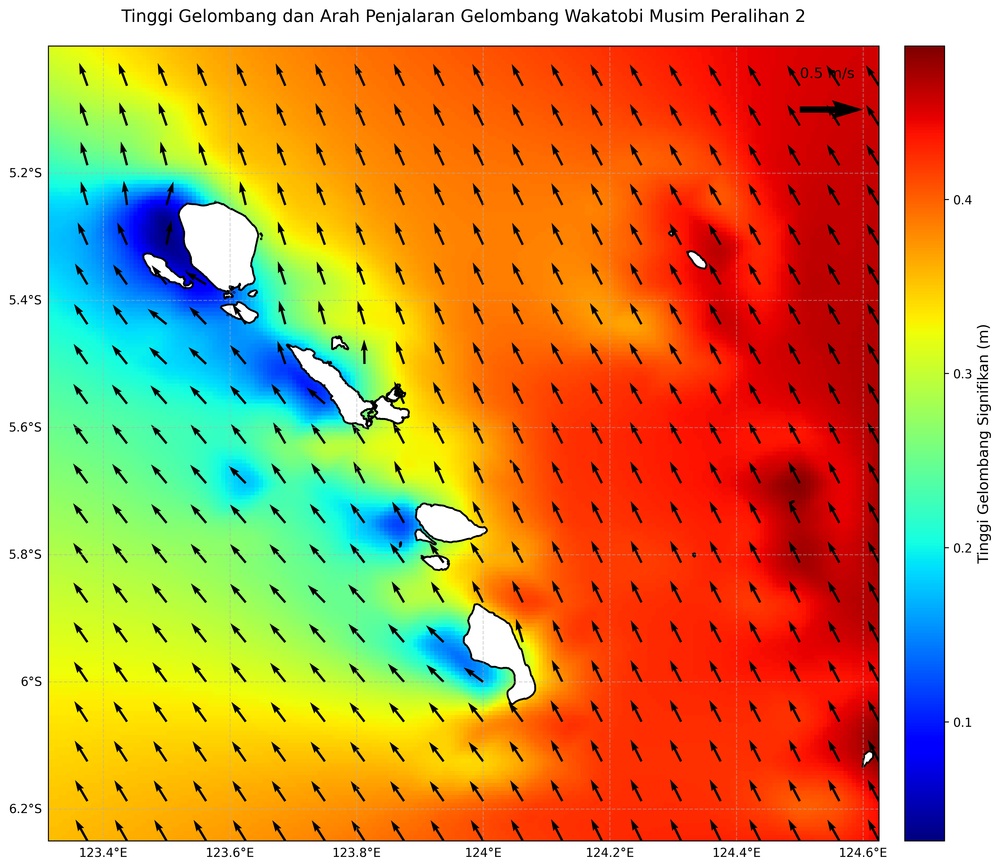

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Buat folder output jika belum ada
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Baca data
shapefile_path = '/content/drive/MyDrive/wakatobi'
ds = xr.open_dataset('/content/drive/MyDrive/data nc/musiman/kombinasi_musimperalihan2.nc')

# Pastikan variabel 'dir' dan 'hs' ada dalam dataset
if 'dir' not in ds or 'hs' not in ds:
    raise ValueError("Variabel 'dir' atau 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')

# Hitung rata-rata arah dan tinggi gelombang sepanjang waktu
dir_mean = ds['dir'].mean(dim='time')
hs_mean = ds['hs'].mean(dim='time')

# Pastikan data longitude dan latitude dalam bentuk yang sama (2D)
lon = ds.lon.values
lat = ds.lat.values
hs_values = hs_mean.values

if lon.ndim == 1 and lat.ndim == 1:
    lon, lat = np.meshgrid(lon, lat)

# Membuat grid yang lebih halus untuk interpolasi
lon_fine = np.linspace(lon.min(), lon.max(), 200)
lat_fine = np.linspace(lat.min(), lat.max(), 200)
lon_fine_grid, lat_fine_grid = np.meshgrid(lon_fine, lat_fine)

# Interpolasi data hs
hs_fine = griddata((lon.flatten(), lat.flatten()), hs_values.flatten(), (lon_fine_grid, lat_fine_grid), method='cubic')

# Konversi arah gelombang ke komponen vektor u dan v
dir_rad = np.deg2rad(dir_mean)
u_dir = -np.sin(dir_rad)
v_dir = -np.cos(dir_rad)

# Buat plot
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot data tinggi gelombang terinterpolasi
hs_plot = ax.pcolormesh(lon_fine_grid, lat_fine_grid, hs_fine, cmap='jet', shading='auto', transform=ccrs.PlateCarree())
cbar = plt.colorbar(hs_plot, ax=ax, orientation='vertical', pad=0.02)
cbar.set_label('Tinggi Gelombang Signifikan (m)', fontsize=12)

# Plot shapefile Wakatobi dengan warna putih
gdf_wakatobi.plot(ax=ax,
                  edgecolor='black',
                  facecolor='white',  # Warna pulau putih
                  linewidth=1.5,
                  transform=ccrs.PlateCarree())

# Tambahkan vektor arah penjalaran gelombang
plt.quiver(lon, lat, u_dir.values, v_dir.values,
           angles='xy', scale_units='xy', scale=26, color='black', transform=ccrs.PlateCarree())

# Tambahkan tanda panah skala
ax.quiver(124.5, -5.1, 0.5, 0, color='black', scale_units='xy', scale=5, transform=ccrs.PlateCarree())
plt.text(124.5, -5.05, '0.5 m/s', transform=ccrs.PlateCarree(), fontsize=12, color='black')

# Tambahkan gridlines dengan label
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Tambahkan label untuk Longitude dan Latitude
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Atur extent peta
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Tambahkan judul
plt.title('Tinggi Gelombang dan Arah Penjalaran Gelombang Wakatobi Musim Peralihan 2',
          pad=20, fontsize=14)

plt.tight_layout()
plt.show()


## **musim barat**

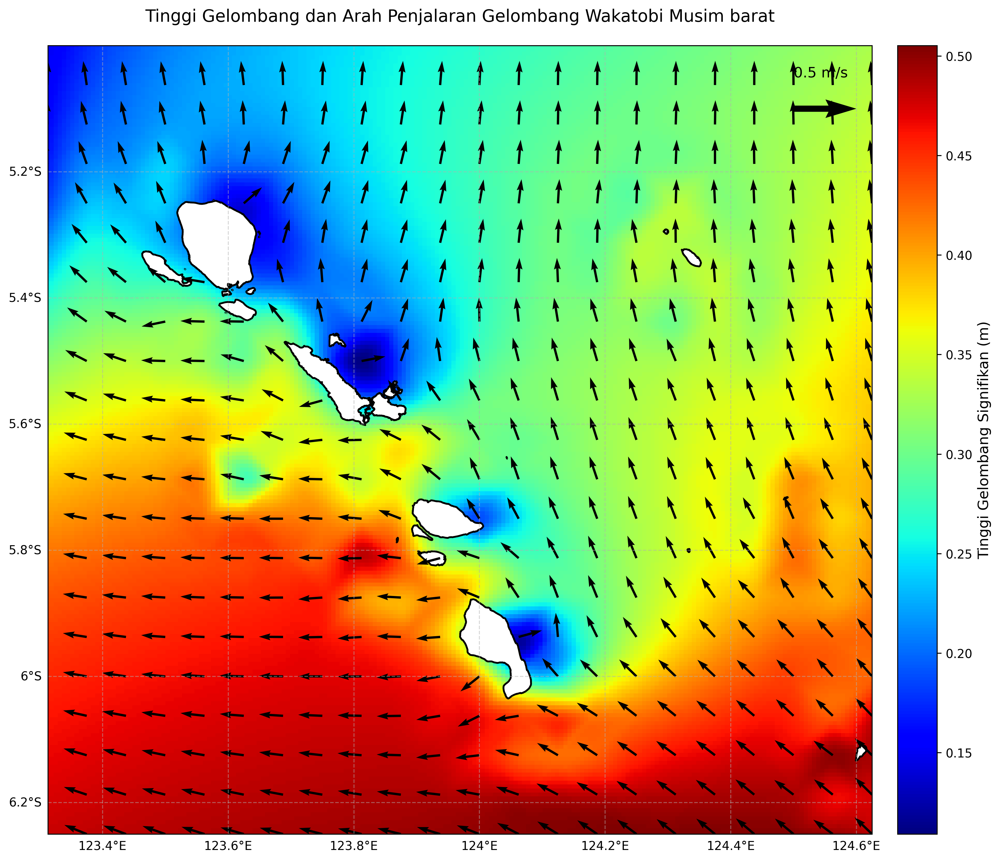

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Buat folder output jika belum ada
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Baca data
shapefile_path = '/content/drive/MyDrive/wakatobi'
ds = xr.open_dataset('/content/drive/MyDrive/data nc/musiman/kombinasi_musimbarat.nc')

# Pastikan variabel 'dir' dan 'hs' ada dalam dataset
if 'dir' not in ds or 'hs' not in ds:
    raise ValueError("Variabel 'dir' atau 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')

# Hitung rata-rata arah dan tinggi gelombang sepanjang waktu
dir_mean = ds['dir'].mean(dim='time')
hs_mean = ds['hs'].mean(dim='time')

# Pastikan data longitude dan latitude dalam bentuk yang sama (2D)
lon = ds.lon.values
lat = ds.lat.values
hs_values = hs_mean.values

if lon.ndim == 1 and lat.ndim == 1:
    lon, lat = np.meshgrid(lon, lat)

# Membuat grid yang lebih halus untuk interpolasi
lon_fine = np.linspace(lon.min(), lon.max(), 200)
lat_fine = np.linspace(lat.min(), lat.max(), 200)
lon_fine_grid, lat_fine_grid = np.meshgrid(lon_fine, lat_fine)

# Interpolasi data hs
hs_fine = griddata((lon.flatten(), lat.flatten()), hs_values.flatten(), (lon_fine_grid, lat_fine_grid), method='cubic')

# Konversi arah gelombang ke komponen vektor u dan v
dir_rad = np.deg2rad(dir_mean)
u_dir = -np.sin(dir_rad)
v_dir = -np.cos(dir_rad)

# Buat plot
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot data tinggi gelombang terinterpolasi
hs_plot = ax.pcolormesh(lon_fine_grid, lat_fine_grid, hs_fine, cmap='jet', shading='auto', transform=ccrs.PlateCarree())
cbar = plt.colorbar(hs_plot, ax=ax, orientation='vertical', pad=0.02)
cbar.set_label('Tinggi Gelombang Signifikan (m)', fontsize=12)

# Plot shapefile Wakatobi dengan warna putih
gdf_wakatobi.plot(ax=ax,
                  edgecolor='black',
                  facecolor='white',  # Warna pulau putih
                  linewidth=1.5,
                  transform=ccrs.PlateCarree())

# Tambahkan vektor arah penjalaran gelombang
plt.quiver(lon, lat, u_dir.values, v_dir.values,
           angles='xy', scale_units='xy', scale=26, color='black', transform=ccrs.PlateCarree())

# Tambahkan tanda panah skala
ax.quiver(124.5, -5.1, 0.5, 0, color='black', scale_units='xy', scale=5, transform=ccrs.PlateCarree())
plt.text(124.5, -5.05, '0.5 m/s', transform=ccrs.PlateCarree(), fontsize=12, color='black')

# Tambahkan gridlines dengan label
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Tambahkan label untuk Longitude dan Latitude
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Atur extent peta
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Tambahkan judul
plt.title('Tinggi Gelombang dan Arah Penjalaran Gelombang Wakatobi Musim barat',
          pad=20, fontsize=14)

plt.tight_layout()
plt.show()


## **musim timur**

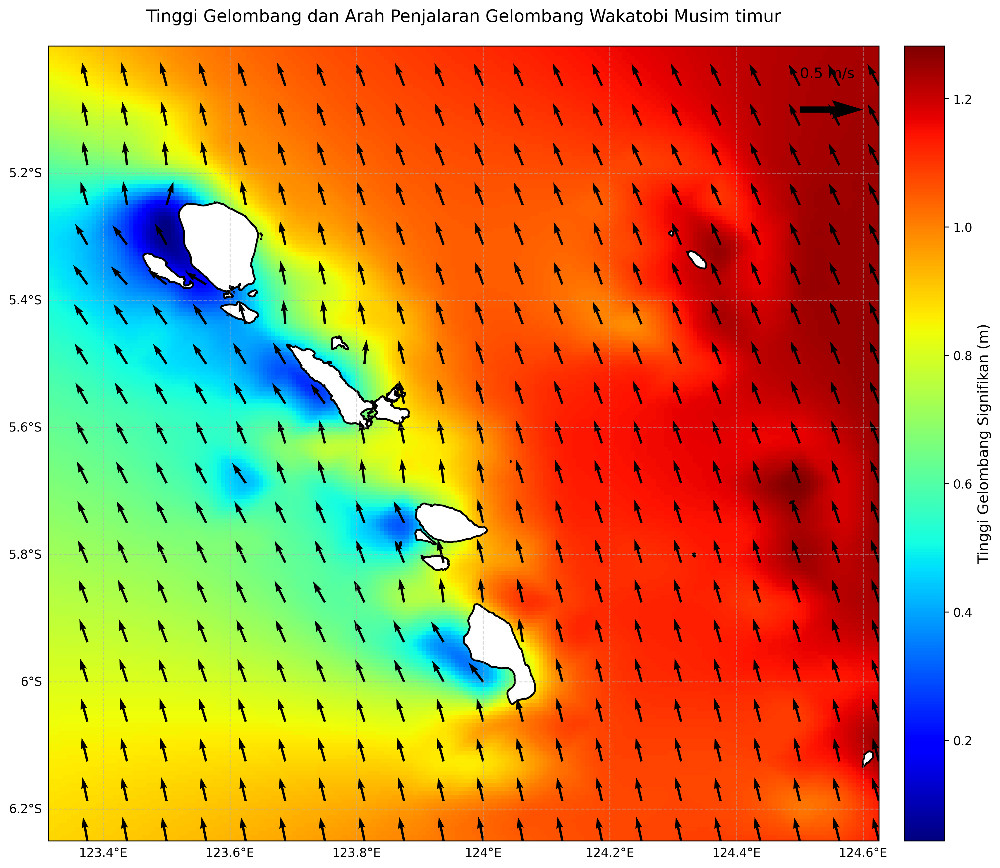

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Buat folder output jika belum ada
output_folder = '/content/drive/MyDrive/output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Baca data
shapefile_path = '/content/drive/MyDrive/wakatobi'
ds = xr.open_dataset('/content/drive/MyDrive/data nc/musiman/kombinasi_musimtimur.nc')

# Pastikan variabel 'dir' dan 'hs' ada dalam dataset
if 'dir' not in ds or 'hs' not in ds:
    raise ValueError("Variabel 'dir' atau 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')

# Hitung rata-rata arah dan tinggi gelombang sepanjang waktu
dir_mean = ds['dir'].mean(dim='time')
hs_mean = ds['hs'].mean(dim='time')

# Pastikan data longitude dan latitude dalam bentuk yang sama (2D)
lon = ds.lon.values
lat = ds.lat.values
hs_values = hs_mean.values

if lon.ndim == 1 and lat.ndim == 1:
    lon, lat = np.meshgrid(lon, lat)

# Membuat grid yang lebih halus untuk interpolasi
lon_fine = np.linspace(lon.min(), lon.max(), 200)
lat_fine = np.linspace(lat.min(), lat.max(), 200)
lon_fine_grid, lat_fine_grid = np.meshgrid(lon_fine, lat_fine)

# Interpolasi data hs
hs_fine = griddata((lon.flatten(), lat.flatten()), hs_values.flatten(), (lon_fine_grid, lat_fine_grid), method='cubic')

# Konversi arah gelombang ke komponen vektor u dan v
dir_rad = np.deg2rad(dir_mean)
u_dir = -np.sin(dir_rad)
v_dir = -np.cos(dir_rad)

# Buat plot
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot data tinggi gelombang terinterpolasi
hs_plot = ax.pcolormesh(lon_fine_grid, lat_fine_grid, hs_fine, cmap='jet', shading='auto', transform=ccrs.PlateCarree())
cbar = plt.colorbar(hs_plot, ax=ax, orientation='vertical', pad=0.02)
cbar.set_label('Tinggi Gelombang Signifikan (m)', fontsize=12)

# Plot shapefile Wakatobi dengan warna putih
gdf_wakatobi.plot(ax=ax,
                  edgecolor='black',
                  facecolor='white',  # Warna pulau putih
                  linewidth=1.5,
                  transform=ccrs.PlateCarree())

# Tambahkan vektor arah penjalaran gelombang
plt.quiver(lon, lat, u_dir.values, v_dir.values,
           angles='xy', scale_units='xy', scale=26, color='black', transform=ccrs.PlateCarree())

# Tambahkan tanda panah skala
ax.quiver(124.5, -5.1, 0.5, 0, color='black', scale_units='xy', scale=5, transform=ccrs.PlateCarree())
plt.text(124.5, -5.05, '0.5 m/s', transform=ccrs.PlateCarree(), fontsize=12, color='black')

# Tambahkan gridlines dengan label
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Tambahkan label untuk Longitude dan Latitude
ax.set_xlabel('Longitude (°E)', fontsize=12)
ax.set_ylabel('Latitude (°S)', fontsize=12)

# Atur extent peta
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Tambahkan judul
plt.title('Tinggi Gelombang dan Arah Penjalaran Gelombang Wakatobi Musim timur',
          pad=20, fontsize=14)

plt.tight_layout()
plt.show()


## **PRINT HASIL ARAHNYA KEMANA **

Arah dominan gelombang di wilayah Wakatobi adalah dari arah: Tenggara


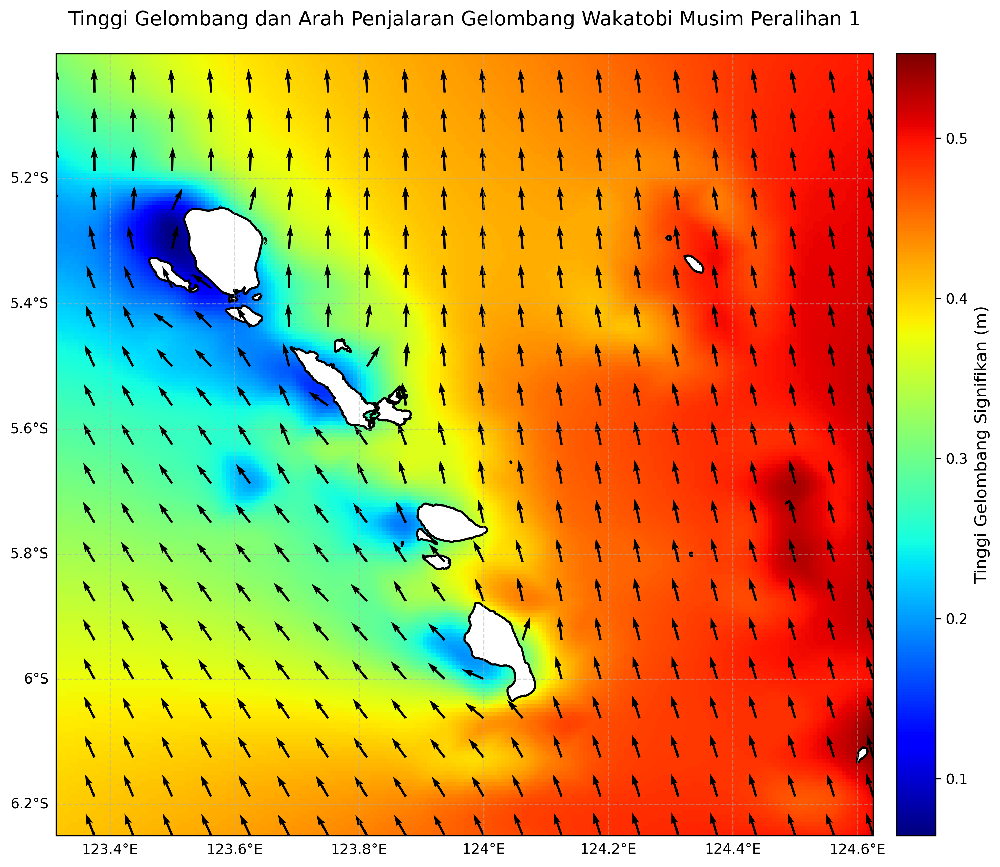

In [ ]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Path ke file NetCDF dan shapefile
file_path = '/content/drive/MyDrive/data nc/musiman/kombinasi_musimperalihan1.nc'
shapefile_path = '/content/drive/MyDrive/wakatobi'

# Baca data NetCDF
ds = xr.open_dataset(file_path)

# Periksa apakah variabel yang dibutuhkan ada dalam dataset
if 'dir' not in ds or 'hs' not in ds:
    raise ValueError("Variabel 'dir' atau 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile untuk wilayah Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')

# Hitung rata-rata arah dan tinggi gelombang sepanjang waktu
dir_mean = ds['dir'].mean(dim='time')
hs_mean = ds['hs'].mean(dim='time')

# Mendapatkan data lon, lat, dan tinggi gelombang
lon = ds.lon.values
lat = ds.lat.values
hs_values = hs_mean.values

# Pastikan data longitude dan latitude dalam bentuk grid 2D
if lon.ndim == 1 and lat.ndim == 1:
    lon, lat = np.meshgrid(lon, lat)

# Grid halus untuk interpolasi data
lon_fine = np.linspace(lon.min(), lon.max(), 200)
lat_fine = np.linspace(lat.min(), lat.max(), 200)
lon_fine_grid, lat_fine_grid = np.meshgrid(lon_fine, lat_fine)

# Interpolasi data tinggi gelombang
hs_fine = griddata((lon.flatten(), lat.flatten()), hs_values.flatten(), (lon_fine_grid, lat_fine_grid), method='cubic')

# Konversi arah penjalaran ke komponen u dan v
dir_rad = np.deg2rad(dir_mean)
u_dir = -np.sin(dir_rad)
v_dir = -np.cos(dir_rad)

# Analisis arah dominan gelombang
direction_counts = np.zeros(8)  # Untuk menghitung arah gelombang dalam 8 arah
for i in range(dir_mean.shape[0]):
    for j in range(dir_mean.shape[1]):
        direction = dir_mean[i, j].item()
        if 0 <= direction < 45:
            direction_counts[0] += 1  # Utara-Timur Laut
        elif 45 <= direction < 90:
            direction_counts[1] += 1  # Timur Laut
        elif 90 <= direction < 135:
            direction_counts[2] += 1  # Timur
        elif 135 <= direction < 180:
            direction_counts[3] += 1  # Tenggara
        elif 180 <= direction < 225:
            direction_counts[4] += 1  # Selatan
        elif 225 <= direction < 270:
            direction_counts[5] += 1  # Barat Daya
        elif 270 <= direction < 315:
            direction_counts[6] += 1  # Barat
        elif 315 <= direction < 360:
            direction_counts[7] += 1  # Barat Laut

# Menentukan arah dominan berdasarkan jumlah tertinggi
directions = [
    "Utara-Timur Laut", "Timur Laut", "Timur", "Tenggara",
    "Selatan", "Barat Daya", "Barat", "Barat Laut"
]
dominant_direction = directions[np.argmax(direction_counts)]

print(f"Arah dominan gelombang di wilayah Wakatobi adalah dari arah: {dominant_direction}")

# Plotting tinggi gelombang dan arah gelombang
plt.figure(figsize=(15, 10), dpi=300)
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot tinggi gelombang
hs_plot = ax.pcolormesh(lon_fine_grid, lat_fine_grid, hs_fine, cmap='jet', shading='auto', transform=ccrs.PlateCarree())
cbar = plt.colorbar(hs_plot, ax=ax, orientation='vertical', pad=0.02)
cbar.set_label('Tinggi Gelombang Signifikan (m)', fontsize=12)

# Plot shapefile Wakatobi
gdf_wakatobi.plot(ax=ax, edgecolor='black', facecolor='white', linewidth=1.5, transform=ccrs.PlateCarree())

# Plot arah penjalaran gelombang
plt.quiver(lon, lat, u_dir.values, v_dir.values, angles='xy', scale_units='xy', scale=26, color='black', transform=ccrs.PlateCarree())

# Tambahkan gridlines dan label
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = False
gl.right_labels = False

# Set extent peta
ax.set_extent([123.313, 124.625, -6.25, -5], crs=ccrs.PlateCarree())

# Judul plot
plt.title('Tinggi Gelombang dan Arah Penjalaran Gelombang Wakatobi Musim Peralihan 1', pad=20, fontsize=14)
plt.show()


Arah dominan gelombang pada Musim Barat: Utara-Timur Laut


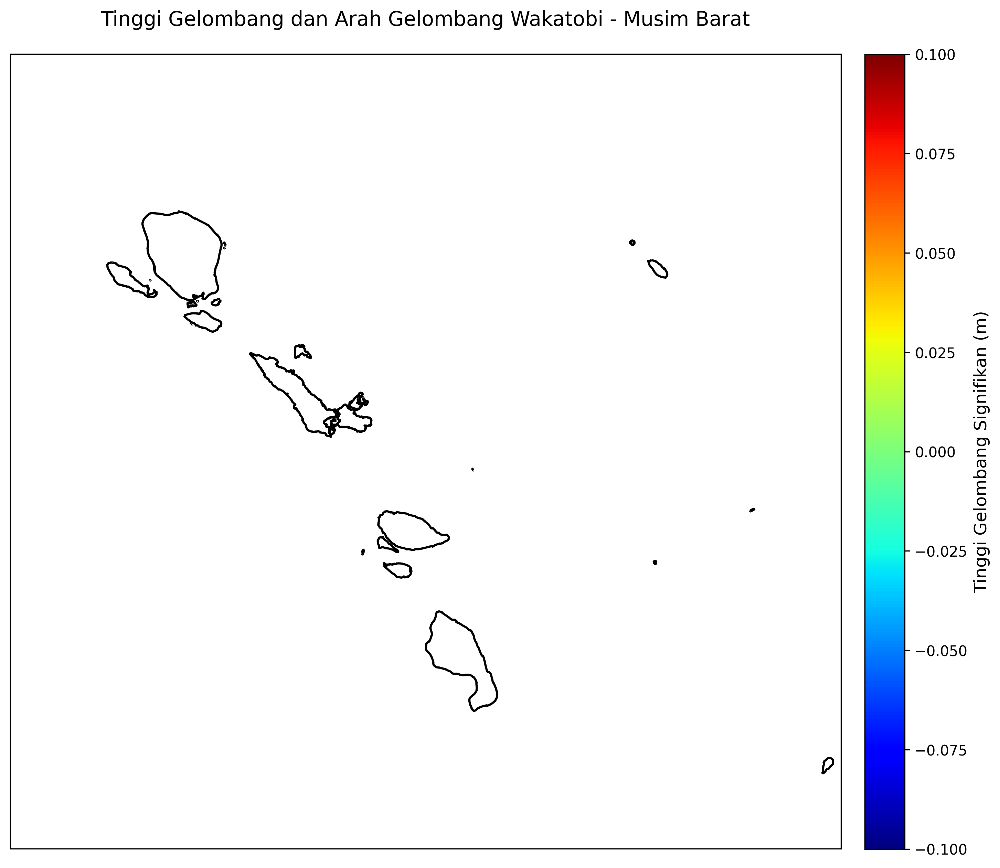

Arah dominan gelombang pada Musim Peralihan I: Tenggara


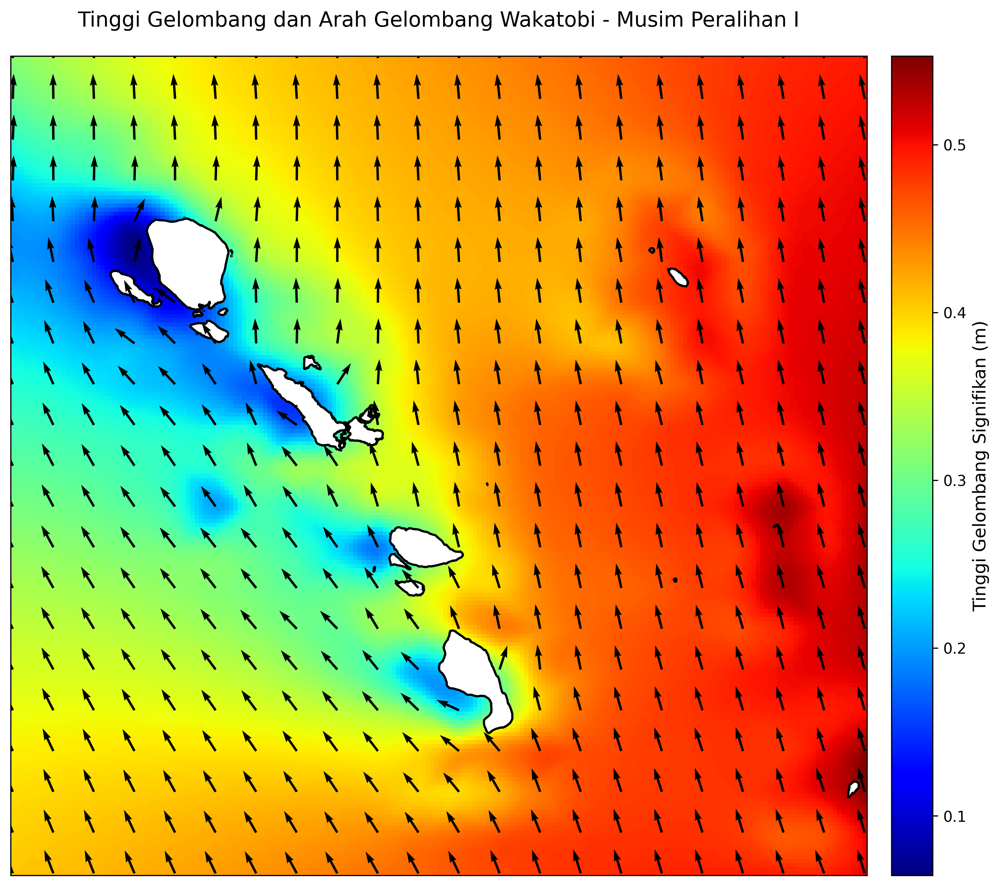

Arah dominan gelombang pada Musim Timur: Tenggara


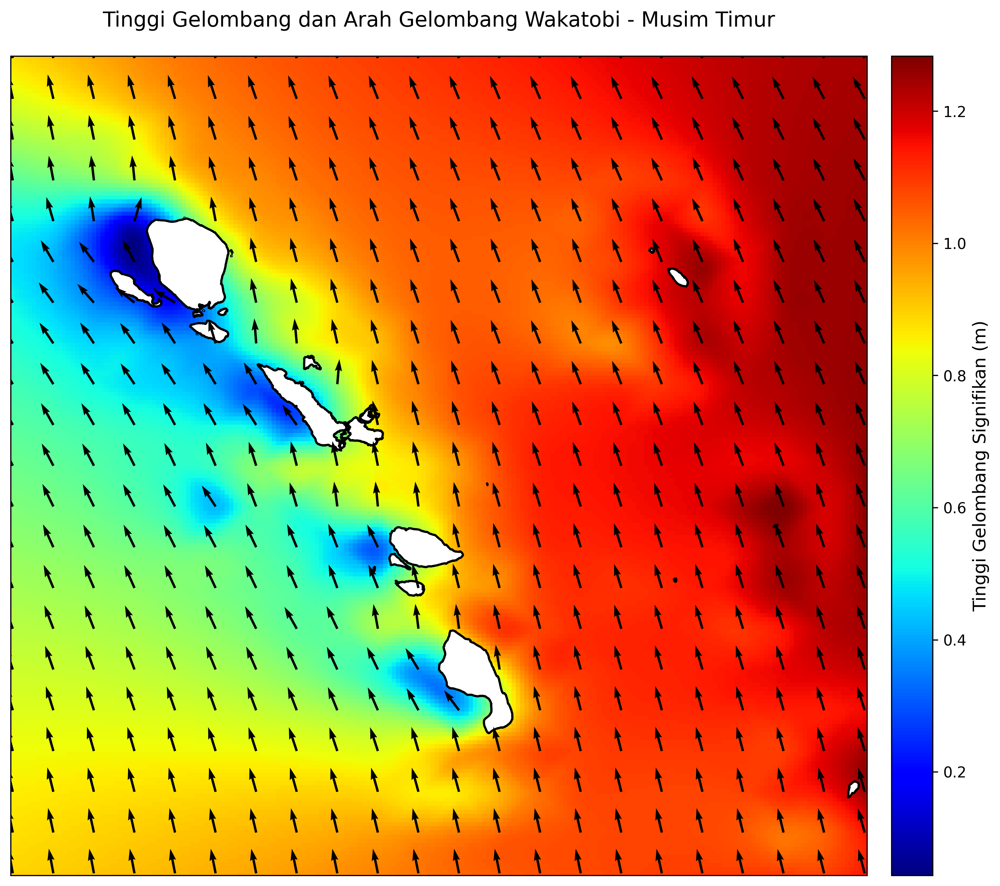

Arah dominan gelombang pada Musim Peralihan II: Tenggara


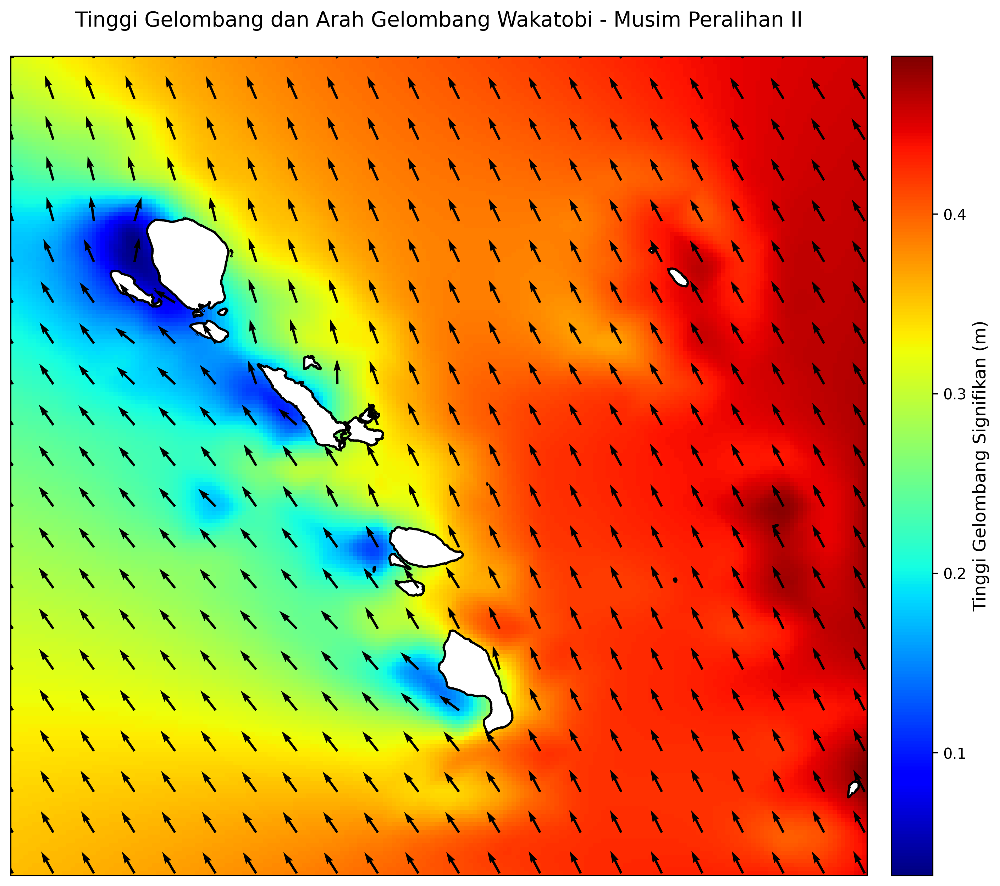

In [ ]:
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import numpy as np
from scipy.interpolate import griddata

# Path ke file NetCDF dan shapefile
file_path = '/content/drive/MyDrive/data nc/tahunan/DATA10TAHUN.nc'
shapefile_path = '/content/drive/MyDrive/wakatobi'

# Baca data NetCDF
ds = xr.open_dataset(file_path)

# Periksa apakah variabel yang dibutuhkan ada dalam dataset
if 'dir' not in ds or 'hs' not in ds:
    raise ValueError("Variabel 'dir' atau 'hs' tidak ditemukan dalam dataset.")

# Baca shapefile untuk wilayah Wakatobi
gdf_wakatobi = gpd.read_file(shapefile_path, layer='ADMINISTRASIKABKOTA_AR_50K')

# Mendefinisikan periode musim dalam setahun dengan format string yang valid
seasons = {
    "Musim Barat": ('12-01', '02-28'),
    "Musim Peralihan I": ('03-01', '05-31'),
    "Musim Timur": ('06-01', '08-31'),
    "Musim Peralihan II": ('09-01', '11-30')
}

# Fungsi untuk analisis arah dominan per musim
def analyze_season(season_name, start_month_day, end_month_day):
    # Mendapatkan semua tahun dalam data untuk cakupan musim yang tepat
    years = np.unique(ds['time.year'].values)

    # Data rata-rata untuk tiap musim dalam semua tahun
    dir_means, hs_means = [], []
    for year in years:
        try:
            start_date = f"{year}-{start_month_day}"
            end_date = f"{year}-{end_month_day}"
            season_data = ds.sel(time=slice(start_date, end_date))

            dir_means.append(season_data['dir'].mean(dim='time'))
            hs_means.append(season_data['hs'].mean(dim='time'))
        except ValueError:
            continue  # Lewati jika terjadi kesalahan pada data di tahun tertentu

    # Hitung rata-rata keseluruhan untuk musim
    dir_mean = xr.concat(dir_means, dim='time').mean(dim='time')
    hs_mean = xr.concat(hs_means, dim='time').mean(dim='time')

    # Mendapatkan data longitude, latitude, dan tinggi gelombang
    lon, lat = np.meshgrid(ds.lon, ds.lat)
    hs_values = hs_mean.values

    # Grid halus untuk interpolasi
    lon_fine = np.linspace(lon.min(), lon.max(), 200)
    lat_fine = np.linspace(lat.min(), lat.max(), 200)
    lon_fine_grid, lat_fine_grid = np.meshgrid(lon_fine, lat_fine)
    hs_fine = griddata((lon.flatten(), lat.flatten()), hs_values.flatten(), (lon_fine_grid, lat_fine_grid), method='cubic')

    # Konversi arah ke komponen u dan v
    dir_rad = np.deg2rad(dir_mean)
    u_dir = -np.sin(dir_rad)
    v_dir = -np.cos(dir_rad)

    # Analisis arah dominan gelombang
    direction_counts = np.zeros(8)  # 8 arah
    for i in range(dir_mean.shape[0]):
        for j in range(dir_mean.shape[1]):
            direction = dir_mean[i, j].item()
            if 0 <= direction < 45:
                direction_counts[0] += 1  # Utara-Timur Laut
            elif 45 <= direction < 90:
                direction_counts[1] += 1  # Timur Laut
            elif 90 <= direction < 135:
                direction_counts[2] += 1  # Timur
            elif 135 <= direction < 180:
                direction_counts[3] += 1  # Tenggara
            elif 180 <= direction < 225:
                direction_counts[4] += 1  # Selatan
            elif 225 <= direction < 270:
                direction_counts[5] += 1  # Barat Daya
            elif 270 <= direction < 315:
                direction_counts[6] += 1  # Barat
            elif 315 <= direction < 360:
                direction_counts[7] += 1  # Barat Laut

    # Menentukan arah dominan
    directions = ["Utara-Timur Laut", "Timur Laut", "Timur", "Tenggara", "Selatan", "Barat Daya", "Barat", "Barat Laut"]
    dominant_direction = directions[np.argmax(direction_counts)]

    print(f"Arah dominan gelombang pada {season_name}: {dominant_direction}")

    # Plotting tinggi gelombang dan arah gelombang
    plt.figure(figsize=(15, 10), dpi=300)
    ax = plt.axes(projection=ccrs.PlateCarree())

    # Plot tinggi gelombang
    hs_plot = ax.pcolormesh(lon_fine_grid, lat_fine_grid, hs_fine, cmap='jet', shading='auto', transform=ccrs.PlateCarree())
    cbar = plt.colorbar(hs_plot, ax=ax, orientation='vertical', pad=0.02)
    cbar.set_label('Tinggi Gelombang Signifikan (m)', fontsize=12)

    # Plot shapefile wilayah Wakatobi
    gdf_wakatobi.plot(ax=ax, edgecolor='black', facecolor='white', linewidth=1.5, transform=ccrs.PlateCarree())

    # Plot arah penjalaran gelombang
    plt.quiver(lon, lat, u_dir.values, v_dir.values, angles='xy', scale_units='xy', scale=26, color='black', transform=ccrs.PlateCarree())

    # Judul plot
    plt.title(f'Tinggi Gelombang dan Arah Gelombang Wakatobi - {season_name}', pad=20, fontsize=14)
    plt.show()

# Jalankan analisis untuk tiap musim
for season_name, (start_month_day, end_month_day) in seasons.items():
    analyze_season(season_name, start_month_day, end_month_day)
